# Modelo de Detección de la Dislexia aplicando Machine Learning

Se va a desarrollar un modelo en Machine Learning que sea capaz de detectar si, tras contestar a 32 questiones y teniendo en cuenta el género, la lengua y la edad, una persona es disléxica o no. Cada modelo se va a entrenar y testear con dos datasets distintos: desktop.csv (Train) y tablet.csv (Test).


Para ello se va a emplear Machine Learning, importando las librerías de python. Los algoritmos que se van a implementar son:
1. K-Nearest Neighbors
2. Logistic Regression
3. Support Vector Machines
4. Random Forest
5. Tree Decision

Y finalmente, en caso de que de tiempo:

6. Neural Networks 

A contiuación, se van a importar las librerías necesarias para desarrollar el modelo de Machine Learning:
- Pandas: proporcina herramientas para el análisis de datos. Mediante esta herramienta se va leer el documento .csv donde se encuentran los datos y se van a manipular con el propósito de diseñar el modelo de Mchine Learning.
- NumPy y Matplotlib: se emplearán para el análisis y la visualización de datos. NumPy permite realizar operación y  matemáticas y manejar datos numéricos de manera eficiente y efectiva. Por otro lado, Matplotlib permite crear gráficas para visualizar los datos de manera simple y clara. 
- Seaborn: al igual que Matplotlib, se trata de una librería de visualización de datos. Sin embargo, ofrece una visualización estadística, la cua va a ser de gran utilidad para analizar la distribución de los datos.
- Warnings: gestionará las advertencias que surjan durante la ejecución del programa. En concreto se va a hacer uso de `warnings.filterwarnings('ignore')` consiguiendo ignorar las posibles advertencias.

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
%matplotlib inline 
warnings.filterwarnings('ignore')

A su vez, para el entrenamiento y el testeo de los distintos algoritmos de Machine Learning, se van a importar las librerías **Scikit-Learn** y para el manejo de desproporción entre casos positivos y negativos se va a importar **Imbalanced-Learn**.

In [5]:
#!pip install -U scikit-learn
#!pip install -U imbalanced-learn

In [6]:
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE
from sklearn import preprocessing
from sklearn.model_selection import KFold

## Modeling Preparation

Se va a comenzar leyendo los datos y exportándolos a las variables *train_df* y *test_df*. Estos datasets van a contener la información con la que se va a construir el modelo. Mediante la librería **pandas** se va a acceder a ellos, siendo capaz de:
- Comprobar si existen valores nulos
- Transformar todos los datos a valores numéricos
- Gestionar los valores nulos
- Analizar si hay variedad dentro de cada dataset

La información que se va a obtener de cada dataset es:

1. Genero (hombre o mujer)
2. Lengua nativa es el español
3. Lengua nativa distinta al español
4. Edad 
5. Información relacionada con las preguntas
6. Disléxico: sí o no

La información relacionada con las preguntas contiene el número de clicks que se realizan en cada ejercicio (*Clicks*), diferenciando en respuestas correctas (*Hits*) e incorrectas (*Misses*). A su vez, se cuenta con el resultado final (*Score*), que se obtiene a partir de la cantidad de aciertos por cuestión, junto con la precisión de la respuesta (*Accuracy = Hits/Clicks*) y el ratio de fallo (*Missrate = Misses/Clicks*).

Mediante estos valores se pretende predecir si una persona tiene dislexia o no.

In [7]:
#Train data set
train_df = pd.read_csv("../data/Dyt-desktop.csv", delimiter=";")
#Test data set
test_df = pd.read_csv("../data/Dyt-tablet.csv", delimiter=";")

pd.set_option("display.max_columns" , None)
pd.set_option("display.max_rows" , None)

In [8]:
# first look train dataset
train_df.head()
train_df.iloc[:, :10].dtypes
train_df.shape

(3644, 197)

In [9]:
# first look test dataset
test_df.head()
test_df.iloc[:, :10].dtypes
test_df.shape

(1395, 197)

Se ha creado una función `prep_Data(df)`que toma como atributo de entrada un dataset y transforma los valores de las columnas *Gender, Nativelang, Otherlang y Dyslexia* en 0's o 1's, en función de su valor incial. De esta forma solo se trabajará con valores numéricos.

In [10]:
def prep_Data(df) :
    #ds.column: access to the column specified
    #map(): itarates through the column specified
    df['Gender'] = df.Gender.map({'Male': 0, 'Female': 1})
    df['Nativelang'] = df.Nativelang.map({'No': 0, 'Yes': 1})
    df['Otherlang'] = df.Otherlang.map({'No': 0, 'Yes': 1})
    df['Dyslexia'] = df.Dyslexia.map({'No': 0, 'Yes': 1})

In [11]:
#transform data
prep_Data(train_df)
prep_Data(test_df)

In [12]:
train_df.head()

,Gender,Nativelang,Otherlang,Age,Clicks1,Hits1,Misses1,Score1,Accuracy1,Missrate1,Clicks2,Hits2,Misses2,Score2,Accuracy2,Missrate2,Clicks3,Hits3,Misses3,Score3,Accuracy3,Missrate3,Clicks4,Hits4,Misses4,Score4,Accuracy4,Missrate4,Clicks5,Hits5,Misses5,Score5,Accuracy5,Missrate5,Clicks6,Hits6,Misses6,Score6,Accuracy6,Missrate6,Clicks7,Hits7,Misses7,Score7,Accuracy7,Missrate7,Clicks8,Hits8,Misses8,Score8,Accuracy8,Missrate8,Clicks9,Hits9,Misses9,Score9,Accuracy9,Missrate9,Clicks10,Hits10,Misses10,Score10,Accuracy10,Missrate10,Clicks11,Hits11,Misses11,Score11,Accuracy11,Missrate11,Clicks12,Hits12,Misses12,Score12,Accuracy12,Missrate12,Clicks13,Hits13,Misses13,Score13,Accuracy13,Missrate13,Clicks14,Hits14,Misses14,Score14,Accuracy14,Missrate14,Clicks15,Hits15,Misses15,Score15,Accuracy15,Missrate15,Clicks16,Hits16,Misses16,Score16,Accuracy16,Missrate16,Clicks17,Hits17,Misses17,Score17,Accuracy17,Missrate17,Clicks18,Hits18,Misses18,Score18,Accuracy18,Missrate18,Clicks19,Hits19,Misses19,Score19,Accuracy19,Missrate19,Clicks20,Hits20,Misses20,Score20,Accuracy20,Missrate20,Clicks21,Hits21,Misses21,Score21,Accuracy21,Missrate21,Clicks22,Hits22,Misses22,Score22,Accuracy22,Missrate22,Clicks23,Hits23,Misses23,Score23,Accuracy23,Missrate23,Clicks24,Hits24,Misses24,Score24,Accuracy24,Missrate24,Clicks25,Hits25,Misses25,Score25,Accuracy25,Missrate25,Clicks26,Hits26,Misses26,Score26,Accuracy26,Missrate26,Clicks27,Hits27,Misses27,Score27,Accuracy27,Missrate27,Clicks28,Hits28,Misses28,Score28,Accuracy28,Missrate28,Clicks29,Hits29,Misses29,Score29,Accuracy29,Missrate29,Clicks30,Hits30,Misses30,Score30,Accuracy30,Missrate30,Clicks31,Hits31,Misses31,Score31,Accuracy31,Missrate31,Clicks32,Hits32,Misses32,Score32,Accuracy32,Missrate32,Dyslexia
0,0,0,1,7,10,10,0,10,1.0,0.0,5,5,0,5,1.0,0.0,6,6,0,6,1.0,0.0,2,2,0,2,1.0,0.0,3,3,0,3,1.0,0.0,4,1,3,1,0.25,0.75,5,5,0,5,1.000000,0.000000,4,3,1,3,0.750000,0.250000,1,0,1,0,0.0,1.0,1,1,0,1,1.000000,0.000000,3,1,2,1,0.333333,0.666667,3,3,0,3,1.0,0.0,3,3,0,3,1.0,0.0,4,4,0,4,1.0,0.0,2,2,0,2,1.0,0.0,2,2,0,2,1.0,0.0,3,3,0,3,1.0,0.0,2,2,0,2,1.00,0.00,4,3,1,3,0.750000,0.250000,5,1,4,1,0.200000,0.800000,3,1,2,1,0.333333,0.666667,4,1,3,1,0.250000,0.750000,4,3,1,3,0.750000,0.250000,3,2,1,2,0.666667,0.333333,3,3,0,3,1.0,0.0,5,3,2,3,0.600000,0.400000,9,1,1,1,0.111111,0.111111,6,2,0,2,0.333333,0.000000,4,1,1,1,0.25,0.25,14,1,2,1,0.071429,0.142857,18,0,0,0,0.000000,0.00,17,2,0,2,0.117647,0.000000,0
1,1,1,1,13,12,12,0,12,1.0,0.0,11,11,0,11,1.0,0.0,10,10,0,10,1.0,0.0,4,4,0,4,1.0,0.0,5,5,0,5,1.0,0.0,5,5,0,5,1.00,0.00,5,4,1,4,0.800000,0.200000,6,5,1,5,0.833333,0.166667,5,4,1,4,0.8,0.2,10,10,0,10,1.000000,0.000000,5,4,1,4,0.800000,0.200000,5,5,0,5,1.0,0.0,4,4,0,4,1.0,0.0,10,10,0,10,1.0,0.0,5,5,0,5,1.0,0.0,4,4,0,4,1.0,0.0,4,4,0,4,1.0,0.0,4,3,1,3,0.75,0.25,8,3,5,3,375.000000,625.000000,3,1,2,1,0.333333,0.666667,3,1,2,1,0.333333,0.666667,9,7,2,7,0.777778,0.222222,6,5,1,5,0.833333,0.166667,3,2,1,2,0.666667,0.333333,5,5,0,5,1.0,0.0,12,8,4,8,0.666667,0.333333,16,2,1,2,125.000000,0.062500,9,2,1,2,0.222222,0.111111,5,0,2,0,0.00,0.40,17,2,2,2,0.117647,0.117647,35,4,0,4,0.114286,0.00,26,2,2,2,0.076923,0.076923,1
2,1,0,1,7,6,6,0,6,1.0,0.0,6,6,0,6,1.0,0.0,6,6,0,6,1.0,0.0,3,3,0,3,1.0,0.0,4,4,0,4,1.0,0.0,2,2,0,2,1.00,0.00,7,5,2,5,0.714286,0.285714,5,3,2,3,0.600000,0.400000,3,3,0,3,1.0,0.0,7,5,2,5,0.714286,0.285714,6,5,1,5,0.833333,0.166667,6,6,0,6,1.0,0.0,3,3,0,3,1.0,0.0,6,6,0,6,1.0,0.0,3,3,0,3,1.0,0.0,4,4,0,4,1.0,0.0,2,2,0,2,1.0,0.0,2,1,1,1,0.50,0.50,5,4,1,4,0.800000,0.200000,6,1,5,1,0.166667,0.833333,6,3,3,3,0.500000,0.500000,6,5,1,5,0.833333,0.166667,5,3,2,3,0.600000,0.400000,4,3,1,3,0.750000,0.250000,5,4,1,4,0.8,0.2,5,2,3,2,0.400000,0.600000,17,2,1,2,0.117647,0.058824,13,3,1,3,0.230769,0.076923,5,0,2,0,0.00,0.40,17,1,3,1,0.058824,0.176471,35,4,0,4,0.114286,0.00,26,1,3,1,0.038462,0.115385,0
3,1,0,1,7,0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,1,1,0,1,1.0,0.0,0,0,0,0,0.0,0.0,2,1,1,1,0.5,0.5,0,0,0,0,0.00,0.00,4,0,4,0,0.000000,1.000000,2,0,2,0,0.000000,1.000

In [13]:
test_df.head()

,Gender,Nativelang,Otherlang,Age,Clicks1,Hits1,Misses1,Score1,Accuracy1,Missrate1,Clicks2,Hits2,Misses2,Score2,Accuracy2,Missrate2,Clicks3,Hits3,Misses3,Score3,Accuracy3,Missrate3,Clicks4,Hits4,Misses4,Score4,Accuracy4,Missrate4,Clicks5,Hits5,Misses5,Score5,Accuracy5,Missrate5,Clicks6,Hits6,Misses6,Score6,Accuracy6,Missrate6,Clicks7,Hits7,Misses7,Score7,Accuracy7,Missrate7,Clicks8,Hits8,Misses8,Score8,Accuracy8,Missrate8,Clicks9,Hits9,Misses9,Score9,Accuracy9,Missrate9,Clicks10,Hits10,Misses10,Score10,Accuracy10,Missrate10,Clicks11,Hits11,Misses11,Score11,Accuracy11,Missrate11,Clicks12,Hits12,Misses12,Score12,Accuracy12,Missrate12,Clicks13,Hits13,Misses13,Score13,Accuracy13,Missrate13,Clicks14,Hits14,Misses14,Score14,Accuracy14,Missrate14,Clicks15,Hits15,Misses15,Score15,Accuracy15,Missrate15,Clicks16,Hits16,Misses16,Score16,Accuracy16,Missrate16,Clicks17,Hits17,Misses17,Score17,Accuracy17,Missrate17,Clicks18,Hits18,Misses18,Score18,Accuracy18,Missrate18,Clicks19,Hits19,Misses19,Score19,Accuracy19,Missrate19,Clicks20,Hits20,Misses20,Score20,Accuracy20,Missrate20,Clicks21,Hits21,Misses21,Score21,Accuracy21,Missrate21,Clicks22,Hits22,Misses22,Score22,Accuracy22,Missrate22,Clicks23,Hits23,Misses23,Score23,Accuracy23,Missrate23,Clicks24,Hits24,Misses24,Score24,Accuracy24,Missrate24,Clicks25,Hits25,Misses25,Score25,Accuracy25,Missrate25,Clicks26,Hits26,Misses26,Score26,Accuracy26,Missrate26,Clicks27,Hits27,Misses27,Score27,Accuracy27,Missrate27,Clicks28,Hits28,Misses28,Score28,Accuracy28,Missrate28,Clicks29,Hits29,Misses29,Score29,Accuracy29,Missrate29,Clicks30,Hits30,Misses30,Score30,Accuracy30,Missrate30,Clicks31,Hits31,Misses31,Score31,Accuracy31,Missrate31,Clicks32,Hits32,Misses32,Score32,Accuracy32,Missrate32,Dyslexia
0,0,1,0,7,6,6,0,6,1.00,0.00,5,4,1,5,0.8,0.2,5,5,0,5,1.000000,0.000000,7,0,7,7,0.0,1.0,5,5,0,5,1.000000,0.000000,4,3,1,4,0.750000,0.250000,4,4,0,4,1.000000,0.000000,4,4,0,4,1.00,0.00,2,2,0,2,1.000000,0.000000,8,0,8,8,0.0,1.0,2,0,2,2,0.000000,1.000000,3,0,3,3,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,7,7,0,7,1.0,0.0,4,4,0,4,1.0,0.0,3,3,0,3,1.0,0.0,5,5,0,5,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,1.0,1.000000,0.000000,4.0,4.0,0.0,4.0,1.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21.0,2.0,2.0,21.0,0.095238,0.095238,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
1,1,1,0,7,7,7,0,7,1.00,0.00,7,7,0,7,1.0,0.0,5,5,0,5,1.000000,0.000000,3,3,0,3,1.0,0.0,4,4,0,4,1.000000,0.000000,7,6,1,7,0.857143,0.142857,5,5,0,5,1.000000,0.000000,2,1,1,2,0.50,0.50,2,2,0,2,1.000000,0.000000,3,3,0,3,1.0,0.0,3,2,1,3,0.666667,0.333333,4,2,2,4,0.500000,0.500000,NaN,NaN,NaN,NaN,NaN,NaN,7,7,0,7,1.0,0.0,4,4,0,4,1.0,0.0,3,3,0,3,1.0,0.0,3,3,0,3,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,2.0,0.000000,1.000000,4.0,0.0,4.0,4.0,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.0,0.0,1.0,13.0,0.000000,0.076923,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
2,1,1,0,7,6,6,0,6,1.00,0.00,7,7,0,7,1.0,0.0,4,0,4,4,0.000000,1.000000,7,0,7,7,0.0,1.0,3,1,2,3,0.333333,0.666667,4,3,1,4,0.750000,0.250000,2,2,0,2,1.000000,0.000000,5,3,2,5,0.60,0.40,6,1,5,6,0.166667,0.833333,7,7,0,7,1.0,0.0,7,2,5,7,0.285714,0.714286,3,2,1,3,0.666667,0.333333,NaN,NaN,NaN,NaN,NaN,NaN,6,6,0,6,1.0,0.0,2,1,1,2,0.5,0.5,5,5,0,5,1.0,0.0,4,4,0,4,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,1.0,4.0,5.0,0.200000,0.800000,4.0,4.0,0.0,4.0,1.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21.0,1.0,3.0,21.0,0.047619,0.142857,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

Tras transformar todos los valores del dataframe en numéricos, se va a asegurar que todos los valores sean tipo flotantes mediante la instrucción: `dataset.apply(lambda x: x.astype('float', errors='ignore'))` donde se aplica el cambio de *int* a *flot* mediante la función `astype()` dentro de una función *lambda* que recorre cada columna, accediendo a su contenido y modificándolo. 

In [14]:
train_df = train_df.apply(lambda x: x.astype('float', errors='ignore'))
test_df = test_df.apply(lambda x: x.astype('float', errors='ignore'))

Una vez se haya transformado el tipo de valor con el que se está trabajando se va a comprobar que los dataframes utilizados solo contienen valores del tipo *float64*:

In [15]:
#check the data type of each column
for col in train_df.columns:
    if train_df[col].dtypes != "float64":
        print("Column {} is not a float, it is {}".format(col, train_df[col].dtypes))

In [16]:
#check the data type of each column
for col in test_df.columns:
    if test_df[col].dtypes != "float64":
        print("Column {} is not a float, it is {}".format(col, test_df[col].dtypes))

Una vez exportados los datos se va a comporbar si hay valores nulos mediante la función `[col for col in test_df.columns if train_df[col].isnull().any()]`. 
- Mediante el bucle `for col in` se van a recorrer todas las columna y acceder a sus valores.  
- Mediante el condicional `if train_df[col].isnull().any()`se va a comprobar si alguno de los datos de la columna que se está analizando es nulo o no. 

En caso de que se encuentre un valor nulo, el atributo de salida `col` tomará el valor de dicha columna y se añadirá a una lista (función entre `[ ]`).

Se obtiene que el dataset correspondiente a los datos *train* no contienen ningún valor nulo, sin mebargo, los datos del dataset *test* sí. Cabe destacar que las columnas correspondientes a la *Question 29* ( 'Clicks29', 'Hits29', 'Misses29', 'Score29', 'Accuracy29', 'Missrate29') no contienen ningún valor. Es decir, dichas columnas solo están compuestas por valores nulos, por lo que no aportan información.

In [17]:
## Train dataset
train_df.describe(include = [np.number])
train_df.isnull().values.any()
train_null_values = train_df.isna().sum().sum()
train_null_col = [col for col in test_df.columns if train_df[col].isnull().any()]
#train_null_col

In [18]:
## Test dataset
test_df.describe(include = [np.number])
test_df.isnull().values.any()
test_null_values = test_df.isna().sum().sum()
test_null_col = [col for col in test_df.columns if test_df[col].isnull().any()]
#test_null_col

### Handle null values

Como se ha mencionado anteriormente, en el dataset correspondiente a *test* existen multitud de valores nulos, los cuales deben ser transformados para poder diseñar el modelo en Machine Learning adecuadamente. Para ello se van a emplear distintas técticas:
1.  **Eliminación de las columnas con valores nulos**: si una fila presenta valores no numéricos, mediante la función `drop()`, se va a prescindir de ella y no se tendrá encuentra en el diseño del modelo.
2. **Sustitución por cero**: si una columna presenta valores no numéricos, se sustituira el valor *Nan* por *0* mediante la función `fillna(0)`. Solo se modificará el dataset *test*, ya que no se está eliminando ninguna fila.
3. **Sustitución por la media y la mediana**: si una columna presenta valores no numéricos, se calculará la media y la mediana de dicha columna mediante las funciones `mean()` y `median()`, respectivamente, se sustituirán los valores *Nan* de cada columna. En caso de que una columna no presente ningún valor numérico se eliminará, tanto en el dataset *test* como *train*, de froma análoga.

Como se ha observado en la sección anterior, en el dataset que se va a usar para testear el modelo las columnas correspondientes a la cuestión 29 no presentan valores numéricos. Por ello, se ha decidido eliminarlas y no tenerlas en cuenta en el estudio, tanto del dataset *train* como *test*.

In [19]:
#columns to be removed
column29 = ['Clicks29', 'Hits29', 'Misses29', 'Score29', 'Accuracy29', 'Missrate29']
#drop Q29
train_df = train_df.drop(column29, axis=1)
test_df = test_df.drop(column29, axis=1)

In [20]:
train_df.head()

,Gender,Nativelang,Otherlang,Age,Clicks1,Hits1,Misses1,Score1,Accuracy1,Missrate1,Clicks2,Hits2,Misses2,Score2,Accuracy2,Missrate2,Clicks3,Hits3,Misses3,Score3,Accuracy3,Missrate3,Clicks4,Hits4,Misses4,Score4,Accuracy4,Missrate4,Clicks5,Hits5,Misses5,Score5,Accuracy5,Missrate5,Clicks6,Hits6,Misses6,Score6,Accuracy6,Missrate6,Clicks7,Hits7,Misses7,Score7,Accuracy7,Missrate7,Clicks8,Hits8,Misses8,Score8,Accuracy8,Missrate8,Clicks9,Hits9,Misses9,Score9,Accuracy9,Missrate9,Clicks10,Hits10,Misses10,Score10,Accuracy10,Missrate10,Clicks11,Hits11,Misses11,Score11,Accuracy11,Missrate11,Clicks12,Hits12,Misses12,Score12,Accuracy12,Missrate12,Clicks13,Hits13,Misses13,Score13,Accuracy13,Missrate13,Clicks14,Hits14,Misses14,Score14,Accuracy14,Missrate14,Clicks15,Hits15,Misses15,Score15,Accuracy15,Missrate15,Clicks16,Hits16,Misses16,Score16,Accuracy16,Missrate16,Clicks17,Hits17,Misses17,Score17,Accuracy17,Missrate17,Clicks18,Hits18,Misses18,Score18,Accuracy18,Missrate18,Clicks19,Hits19,Misses19,Score19,Accuracy19,Missrate19,Clicks20,Hits20,Misses20,Score20,Accuracy20,Missrate20,Clicks21,Hits21,Misses21,Score21,Accuracy21,Missrate21,Clicks22,Hits22,Misses22,Score22,Accuracy22,Missrate22,Clicks23,Hits23,Misses23,Score23,Accuracy23,Missrate23,Clicks24,Hits24,Misses24,Score24,Accuracy24,Missrate24,Clicks25,Hits25,Misses25,Score25,Accuracy25,Missrate25,Clicks26,Hits26,Misses26,Score26,Accuracy26,Missrate26,Clicks27,Hits27,Misses27,Score27,Accuracy27,Missrate27,Clicks28,Hits28,Misses28,Score28,Accuracy28,Missrate28,Clicks30,Hits30,Misses30,Score30,Accuracy30,Missrate30,Clicks31,Hits31,Misses31,Score31,Accuracy31,Missrate31,Clicks32,Hits32,Misses32,Score32,Accuracy32,Missrate32,Dyslexia
0,0.0,0.0,1.0,7.0,10.0,10.0,0.0,10.0,1.0,0.0,5.0,5.0,0.0,5.0,1.0,0.0,6.0,6.0,0.0,6.0,1.0,0.0,2.0,2.0,0.0,2.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,4.0,1.0,3.0,1.0,0.25,0.75,5.0,5.0,0.0,5.0,1.000000,0.000000,4.0,3.0,1.0,3.0,0.750000,0.250000,1.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.000000,0.000000,3.0,1.0,2.0,1.0,0.333333,0.666667,3.0,3.0,0.0,3.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,2.0,2.0,0.0,2.0,1.0,0.0,2.0,2.0,0.0,2.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,2.0,2.0,0.0,2.0,1.00,0.00,4.0,3.0,1.0,3.0,0.750000,0.250000,5.0,1.0,4.0,1.0,0.200000,0.800000,3.0,1.0,2.0,1.0,0.333333,0.666667,4.0,1.0,3.0,1.0,0.250000,0.750000,4.0,3.0,1.0,3.0,0.750000,0.250000,3.0,2.0,1.0,2.0,0.666667,0.333333,3.0,3.0,0.0,3.0,1.0,0.0,5.0,3.0,2.0,3.0,0.600000,0.400000,9.0,1.0,1.0,1.0,0.111111,0.111111,6.0,2.0,0.0,2.0,0.333333,0.000000,14.0,1.0,2.0,1.0,0.071429,0.142857,18.0,0.0,0.0,0.0,0.000000,0.00,17.0,2.0,0.0,2.0,0.117647,0.000000,0.0
1,1.0,1.0,1.0,13.0,12.0,12.0,0.0,12.0,1.0,0.0,11.0,11.0,0.0,11.0,1.0,0.0,10.0,10.0,0.0,10.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,5.0,5.0,0.0,5.0,1.0,0.0,5.0,5.0,0.0,5.0,1.00,0.00,5.0,4.0,1.0,4.0,0.800000,0.200000,6.0,5.0,1.0,5.0,0.833333,0.166667,5.0,4.0,1.0,4.0,0.8,0.2,10.0,10.0,0.0,10.0,1.000000,0.000000,5.0,4.0,1.0,4.0,0.800000,0.200000,5.0,5.0,0.0,5.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,10.0,10.0,0.0,10.0,1.0,0.0,5.0,5.0,0.0,5.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,4.0,3.0,1.0,3.0,0.75,0.25,8.0,3.0,5.0,3.0,375.000000,625.000000,3.0,1.0,2.0,1.0,0.333333,0.666667,3.0,1.0,2.0,1.0,0.333333,0.666667,9.0,7.0,2.0,7.0,0.777778,0.222222,6.0,5.0,1.0,5.0,0.833333,0.166667,3.0,2.0,1.0,2.0,0.666667,0.333333,5.0,5.0,0.0,5.0,1.0,0.0,12.0,8.0,4.0,8.0,0.666667,0.333333,16.0,2.0,1.0,2.0,125.000000,0.062500,9.0,2.0,1.0,2.0,0.222222,0.111111,17.0,2.0,2.0,2.0,0.117647,0.117647,35.0,4.0,0.0,4.0,0.114286,0.00,26.0,2.0,2.0,2.0,0.076923,0.076923,1.0
2,1.0,0.0,1.0,7.0,6.0,6.0,0.0,6.0,1.0,0.0,6.0,6.0,0.0,6.0,1.0,0.0,6.0,6.0,0.0,6.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,2.0,2.0,0.0,2.0,1.00,0.00,7.0,5.0,2.0,5.0,0.714286,0.285714,5.0,3.0,2.0,3.0,0.600000,0.400000,3.0,3.0,0.0,3.0,1.0,0.0,7.0,5.0,2.0,5.0,0.714286,0.285714,6.0,5.0,1.0,5.0,0.833333,0.166667,6.0,6.0,0.0,6.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,6.0,6.0,0.0,6.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,4.

In [21]:
test_df.head()

,Gender,Nativelang,Otherlang,Age,Clicks1,Hits1,Misses1,Score1,Accuracy1,Missrate1,Clicks2,Hits2,Misses2,Score2,Accuracy2,Missrate2,Clicks3,Hits3,Misses3,Score3,Accuracy3,Missrate3,Clicks4,Hits4,Misses4,Score4,Accuracy4,Missrate4,Clicks5,Hits5,Misses5,Score5,Accuracy5,Missrate5,Clicks6,Hits6,Misses6,Score6,Accuracy6,Missrate6,Clicks7,Hits7,Misses7,Score7,Accuracy7,Missrate7,Clicks8,Hits8,Misses8,Score8,Accuracy8,Missrate8,Clicks9,Hits9,Misses9,Score9,Accuracy9,Missrate9,Clicks10,Hits10,Misses10,Score10,Accuracy10,Missrate10,Clicks11,Hits11,Misses11,Score11,Accuracy11,Missrate11,Clicks12,Hits12,Misses12,Score12,Accuracy12,Missrate12,Clicks13,Hits13,Misses13,Score13,Accuracy13,Missrate13,Clicks14,Hits14,Misses14,Score14,Accuracy14,Missrate14,Clicks15,Hits15,Misses15,Score15,Accuracy15,Missrate15,Clicks16,Hits16,Misses16,Score16,Accuracy16,Missrate16,Clicks17,Hits17,Misses17,Score17,Accuracy17,Missrate17,Clicks18,Hits18,Misses18,Score18,Accuracy18,Missrate18,Clicks19,Hits19,Misses19,Score19,Accuracy19,Missrate19,Clicks20,Hits20,Misses20,Score20,Accuracy20,Missrate20,Clicks21,Hits21,Misses21,Score21,Accuracy21,Missrate21,Clicks22,Hits22,Misses22,Score22,Accuracy22,Missrate22,Clicks23,Hits23,Misses23,Score23,Accuracy23,Missrate23,Clicks24,Hits24,Misses24,Score24,Accuracy24,Missrate24,Clicks25,Hits25,Misses25,Score25,Accuracy25,Missrate25,Clicks26,Hits26,Misses26,Score26,Accuracy26,Missrate26,Clicks27,Hits27,Misses27,Score27,Accuracy27,Missrate27,Clicks28,Hits28,Misses28,Score28,Accuracy28,Missrate28,Clicks30,Hits30,Misses30,Score30,Accuracy30,Missrate30,Clicks31,Hits31,Misses31,Score31,Accuracy31,Missrate31,Clicks32,Hits32,Misses32,Score32,Accuracy32,Missrate32,Dyslexia
0,0.0,1.0,0.0,7.0,6.0,6.0,0.0,6.0,1.00,0.00,5.0,4.0,1.0,5.0,0.8,0.2,5.0,5.0,0.0,5.0,1.000000,0.000000,7.0,0.0,7.0,7.0,0.0,1.0,5.0,5.0,0.0,5.0,1.000000,0.000000,4.0,3.0,1.0,4.0,0.750000,0.250000,4.0,4.0,0.0,4.0,1.000000,0.000000,4.0,4.0,0.0,4.0,1.00,0.00,2.0,2.0,0.0,2.0,1.000000,0.000000,8.0,0.0,8.0,8.0,0.0,1.0,2.0,0.0,2.0,2.0,0.000000,1.000000,3.0,0.0,3.0,3.0,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,7.0,7.0,0.0,7.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,5.0,5.0,0.0,5.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,1.0,1.000000,0.000000,4.0,4.0,0.0,4.0,1.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21.0,2.0,2.0,21.0,0.095238,0.095238,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
1,1.0,1.0,0.0,7.0,7.0,7.0,0.0,7.0,1.00,0.00,7.0,7.0,0.0,7.0,1.0,0.0,5.0,5.0,0.0,5.0,1.000000,0.000000,3.0,3.0,0.0,3.0,1.0,0.0,4.0,4.0,0.0,4.0,1.000000,0.000000,7.0,6.0,1.0,7.0,0.857143,0.142857,5.0,5.0,0.0,5.0,1.000000,0.000000,2.0,1.0,1.0,2.0,0.50,0.50,2.0,2.0,0.0,2.0,1.000000,0.000000,3.0,3.0,0.0,3.0,1.0,0.0,3.0,2.0,1.0,3.0,0.666667,0.333333,4.0,2.0,2.0,4.0,0.500000,0.500000,NaN,NaN,NaN,NaN,NaN,NaN,7.0,7.0,0.0,7.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,3.0,3.0,0.0,3.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,2.0,0.000000,1.000000,4.0,0.0,4.0,4.0,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.0,0.0,1.0,13.0,0.000000,0.076923,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
2,1.0,1.0,0.0,7.0,6.0,6.0,0.0,6.0,1.00,0.00,7.0,7.0,0.0,7.0,1.0,0.0,4.0,0.0,4.0,4.0,0.000000,1.000000,7.0,0.0,7.0,7.0,0.0,1.0,3.0,1.0,2.0,3.0,0.333333,0.666667,4.0,3.0,1.0,4.0,0.750000,0.250000,2.0,2.0,0.0,2.0,1.000000,0.000000,5.0,3.0,2.0,5.0,0.60,0.40,6.0,1.0,5.0,6.0,0.166667,0.833333,7.0,7.0,0.0,7.0,1.0,0.0,7.0,2.0,5.0,7.0,0.285714,0.714286,3.0,2.0,1.0,3.0,0.666667,0.333333,NaN,NaN,NaN,NaN,NaN,NaN,6.0,6.0,0.0,6.0,1.0,0.0,2.0,1.0,1.0,2.0,0.5,0.5,5.0,5.0,0.0,5.0,1.0,0.0,4.0,4.0,0.0,4.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

Antes de proceder con el ajuste los valores nulos, para no influir erróneamente en el cálculo de la media y la mediana, se va a prescindir de todos los valores mayores a uno en las columnas *Accuracy* y *Missrate*. Los valores mencionados representan porcentajes, por lo que no pueden superar la unidad, sin embargo, si se estudia en detalle cada variable existen valores que no cumplen este requisito dando lugar a error si no se corrige.

In [22]:
def remove_outliers_manually(df):
    print("Old Shape: ", df.shape)
    
    #Accuracy and Missrate
    for i in range(int(df.shape[1]/6)):
        col_acc_rate = df.columns[8+6*i:10+6*i]
        for j in col_acc_rate:
            df.drop(df[df[j] > 1].index, inplace=True)
    print("New Shape: ", df.shape)

In [23]:
remove_outliers_manually(train_df)
remove_outliers_manually(test_df)

Old Shape:  (3644, 191)
New Shape:  (2101, 191)
Old Shape:  (1395, 191)
New Shape:  (874, 191)


In [24]:
##1 DROP
# Drop columns from train dataset
train_drop = train_df.dropna()
# Drop columns from test dataset
test_drop = test_df.dropna()

##2 ZEROS
# Fill with zeros columns train dataset
train_zero = train_df.fillna(0)
# Fill with zeros columns test dataset
test_zero = test_df.fillna(0)

##3 MEAN & MEDIAN
#3.1 MEAN
#Mean Fill
train_mean = train_df.fillna(train_df.mean())
test_mean = test_df.fillna(test_df.mean())
#3.2 MEDIAN
#Median Fill
train_median = train_df.fillna(train_df.median())
test_median = test_df.fillna(test_df.median())

Tras realizar las modificaciones convenientes, se va a comprobar que ningún dataset contiene valores nulos:

#### 1. Drop

In [25]:
#1 DROP
test_drop.head()
test_null_col_drop = [col for col in test_drop.columns if test_drop[col].isnull().any()]
test_null_col_drop

[]

#### 2. Zero

In [26]:
#2 ZEROS
test_zero.head()
test_null_col_zero = [col for col in test_zero.columns if test_zero[col].isnull().any()]
test_null_col_zero

[]

#### 3.1. Mean

In [27]:
#3.1 MEAN
test_mean.head()
test_null_col_mean = [col for col in test_mean.columns if test_mean[col].isnull().any()]
test_null_col_mean

[]

#### 3.2. Median

In [28]:
#3.2 MEDIAN
test_median.head()
test_null_col_median = [col for col in test_median.columns if test_median[col].isnull().any()]
test_null_col_median

[]

### Handling outliers

A continuación, se va a proceder con la eliminación de los outliers, es decir, se va a prescindir de aquellos valores que se consideren anómalos. Para ello se van a emplear dos funciones *.describe()* y *sns.distplot(col)*. La primera  se utiliza para representar la distribución de los datos en un gráfico. Va a permitir visualizar la forma en que los datos están distribuidos en los datasets disponibles. A simple vista, se puede identificar como hay valores máximos que están muy alejados del percentil 75, por lo que se puede intuir que se trata de un outlier.

A su vez, la función `countplot` es útil para identificar cuantos valores positivos y negativos hay de dislexia. Se va a representar visualmente, permitiendo comparar si la muestra que se está usando es representativa de la población.

In [29]:
train_df.describe()

,Gender,Nativelang,Otherlang,Age,Clicks1,Hits1,Misses1,Score1,Accuracy1,Missrate1,Clicks2,Hits2,Misses2,Score2,Accuracy2,Missrate2,Clicks3,Hits3,Misses3,Score3,Accuracy3,Missrate3,Clicks4,Hits4,Misses4,Score4,Accuracy4,Missrate4,Clicks5,Hits5,Misses5,Score5,Accuracy5,Missrate5,Clicks6,Hits6,Misses6,Score6,Accuracy6,Missrate6,Clicks7,Hits7,Misses7,Score7,Accuracy7,Missrate7,Clicks8,Hits8,Misses8,Score8,Accuracy8,Missrate8,Clicks9,Hits9,Misses9,Score9,Accuracy9,Missrate9,Clicks10,Hits10,Misses10,Score10,Accuracy10,Missrate10,Clicks11,Hits11,Misses11,Score11,Accuracy11,Missrate11,Clicks12,Hits12,Misses12,Score12,Accuracy12,Missrate12,Clicks13,Hits13,Misses13,Score13,Accuracy13,Missrate13,Clicks14,Hits14,Misses14,Score14,Accuracy14,Missrate14,Clicks15,Hits15,Misses15,Score15,Accuracy15,Missrate15,Clicks16,Hits16,Misses16,Score16,Accuracy16,Missrate16,Clicks17,Hits17,Misses17,Score17,Accuracy17,Missrate17,Clicks18,Hits18,Misses18,Score18,Accuracy18,Missrate18,Clicks19,Hits19,Misses19,Score19,Accuracy19,Missrate19,Clicks20,Hits20,Misses20,Score20,Accuracy20,Missrate20,Clicks21,Hits21,Misses21,Score21,Accuracy21,Missrate21,Clicks22,Hits22,Misses22,Score22,Accuracy22,Missrate22,Clicks23,Hits23,Misses23,Score23,Accuracy23,Missrate23,Clicks24,Hits24,Misses24,Score24,Accuracy24,Missrate24,Clicks25,Hits25,Misses25,Score25,Accuracy25,Missrate25,Clicks26,Hits26,Misses26,Score26,Accuracy26,Missrate26,Clicks27,Hits27,Misses27,Score27,Accuracy27,Missrate27,Clicks28,Hits28,Misses28,Score28,Accuracy28,Missrate28,Clicks30,Hits30,Misses30,Score30,Accuracy30,Missrate30,Clicks31,Hits31,Misses31,Score31,Accuracy31,Missrate31,Clicks32,Hits32,Misses32,Score32,Accuracy32,Missrate32,Dyslexia
count,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.00000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.00000,2101.000000,2101.000000,2101.000000,2101.000000,2101.00000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000,2101.000000
mean,0.49928

In [30]:
test_df.describe()

,Gender,Nativelang,Otherlang,Age,Clicks1,Hits1,Misses1,Score1,Accuracy1,Missrate1,Clicks2,Hits2,Misses2,Score2,Accuracy2,Missrate2,Clicks3,Hits3,Misses3,Score3,Accuracy3,Missrate3,Clicks4,Hits4,Misses4,Score4,Accuracy4,Missrate4,Clicks5,Hits5,Misses5,Score5,Accuracy5,Missrate5,Clicks6,Hits6,Misses6,Score6,Accuracy6,Missrate6,Clicks7,Hits7,Misses7,Score7,Accuracy7,Missrate7,Clicks8,Hits8,Misses8,Score8,Accuracy8,Missrate8,Clicks9,Hits9,Misses9,Score9,Accuracy9,Missrate9,Clicks10,Hits10,Misses10,Score10,Accuracy10,Missrate10,Clicks11,Hits11,Misses11,Score11,Accuracy11,Missrate11,Clicks12,Hits12,Misses12,Score12,Accuracy12,Missrate12,Clicks13,Hits13,Misses13,Score13,Accuracy13,Missrate13,Clicks14,Hits14,Misses14,Score14,Accuracy14,Missrate14,Clicks15,Hits15,Misses15,Score15,Accuracy15,Missrate15,Clicks16,Hits16,Misses16,Score16,Accuracy16,Missrate16,Clicks17,Hits17,Misses17,Score17,Accuracy17,Missrate17,Clicks18,Hits18,Misses18,Score18,Accuracy18,Missrate18,Clicks19,Hits19,Misses19,Score19,Accuracy19,Missrate19,Clicks20,Hits20,Misses20,Score20,Accuracy20,Missrate20,Clicks21,Hits21,Misses21,Score21,Accuracy21,Missrate21,Clicks22,Hits22,Misses22,Score22,Accuracy22,Missrate22,Clicks23,Hits23,Misses23,Score23,Accuracy23,Missrate23,Clicks24,Hits24,Misses24,Score24,Accuracy24,Missrate24,Clicks25,Hits25,Misses25,Score25,Accuracy25,Missrate25,Clicks26,Hits26,Misses26,Score26,Accuracy26,Missrate26,Clicks27,Hits27,Misses27,Score27,Accuracy27,Missrate27,Clicks28,Hits28,Misses28,Score28,Accuracy28,Missrate28,Clicks30,Hits30,Misses30,Score30,Accuracy30,Missrate30,Clicks31,Hits31,Misses31,Score31,Accuracy31,Missrate31,Clicks32,Hits32,Misses32,Score32,Accuracy32,Missrate32,Dyslexia
count,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,580.000000,580.000000,580.000000,580.000000,580.000000,580.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,580.000000,580.000000,580.000000,580.000000,580.000000,580.000000,580.000000,580.000000,580.000000,580.000000,580.000000,580.000000,578.000000,578.000000,578.000000,578.000000,580.000000,580.000000,237.000000,237.000000,237.000000,237.000000,237.000000,237.000000,872.00000,872.000000,872.000000,872.00000,874.000000,874.000000,872.000000,872.000000,872.000000,872.000000,874.000000,874.000000,578.000000,578.000000,578.000000,578.000000,580.000000,580.000000,237.000000,237.000000,237.000000,237.000000,237.000000,237.000000,578.000000,578.000000,578.000000,578.000000,580.000000,580.000000,578.000000,578.000000,578.000000,578.000000,580.000000,580.000000,577.000000,577.000000,577.000000,577.000000,580.000000,580.000000,871.000000,871.000000,871.000000,871.000000,874.000000,874.000000,236.000000,236.000000,236.000000,236.000000,237.000000,237.000000,236.000000,236.000000,236.000000,236.000000,237.000000,237.000000,874.000000
mean,0.510297,0.953089,0.091533,10.054920,7.526316,7.255149,0.271167,7.526316,0.938984,0.048431,7.367277,6.989703,0.377574,7.367277,0.933682,0.061741,6.104119,5.615561,0.488558,6.104119,0.926201,0.07379

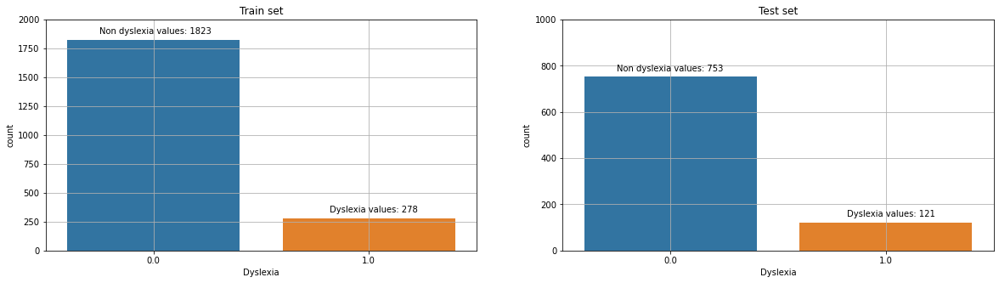

In [31]:
#Dyslexia histogram 
dyslexia_train = train_df['Dyslexia'].value_counts()
dyslexia_test = test_df['Dyslexia'].value_counts()


fig, ax = plt.subplots(1,2, figsize=(20,5))

sns.barplot(x=dyslexia_train.index, y=dyslexia_train.values, ax=ax[0])
ax[0].set_title('Train set')
ax[0].set_ylim([0, 2000])
ax[0].grid(True)
ax[0].annotate('Non dyslexia values: '+str(dyslexia_train[0]), xy=(1, dyslexia_train[0]), xytext=(-0.25,  dyslexia_train[0]+50))
ax[0].annotate('Dyslexia values: '+str(dyslexia_train[1]), xy=(1, dyslexia_train[1]), xytext=(0.82,  dyslexia_train[1]+50))

sns.barplot(x=dyslexia_test.index, y=dyslexia_test.values, ax=ax[1])
ax[1].set_title('Test set')
ax[1].set_ylim([0, 1000])
ax[1].grid(True)
ax[1].annotate('Non dyslexia values: '+str(dyslexia_test[0]), xy=(1, dyslexia_test[0]), xytext=(-0.25,  dyslexia_test[0]+25))
ax[1].annotate('Dyslexia values: '+str(dyslexia_test[1]), xy=(1, dyslexia_test[1]), xytext=(0.82,  dyslexia_test[1]+25))

plt.savefig('MLmodel-WHI.png')
plt.show()

Tras observar la distribución de los *dataset* originales y comprobar como sí presentan outliers, se va a proceder con el análisis y la eliminación de aquellos valores que no aporten información válida y vayan a afectar negativamente al modelo.

La función `distplot` se va a emplear para identificar la forma en que los datos están distribuidos, verificando si siguen una distribución normal o no, como afecta la presencia de outliers a la distribución y cual es la media y la desviación estándar. Es decir, se va a representar visualmente la distribución de los datos de cada variable.

La función `boxplot`representa el rango intercuartílico (IQR) de los datos. La caja (gráfico) va desde el primer cuartil (Q1) hasta el tercer cuartil (Q3), y su longitud representa el rango intercuartílico (IQR = Q3 - Q1). Los valores atípicos (outliers) son aquellos que están fuera del rango definido por 1,5 veces el IQR.

In [32]:
def plot_dist(df):
    
    rest = df.shape[1] % 4
    rows = df.shape[1]//4
    
    if rest == 0:
        rows = rows
    else:
        rows = rows + 1
        
    fig, ax = plt.subplots(ncols = 4, nrows = rows, figsize = (15, 150))
    i = 0
    ax = ax.flatten()

    for col in df.columns:
        plt.title(col)
        sns.distplot(df[col], ax=ax[i])
        i+=1
    plt.tight_layout(pad = 0.5, w_pad = 0.7, h_pad = 2.0)

In [33]:
def plot_box_whisker(df):
    
    rest = df.shape[1] % 4
    rows = df.shape[1]//4
    
    if rest == 0:
        rows = rows
    else:
        rows = rows + 1

    fig, ax = plt.subplots(ncols = 4, nrows = rows, figsize = (15, 150))
    i = 0
    ax = ax.flatten()
    
    for col in df.columns:
        plt.title(col)
        df.boxplot([col], ax=ax[i])
        i+=1
    plt.tight_layout(pad = 0.5, w_pad = 0.7, h_pad = 2.0)

In [34]:
#1 DROP
train_drop_Q = train_drop.drop(columns = ['Gender','Nativelang','Otherlang','Age','Dyslexia'], axis = 1)
test_drop_Q = test_drop.drop(columns = ['Gender','Nativelang','Otherlang','Age','Dyslexia'], axis = 1)

#2 ZEROS
train_zero_Q = train_zero.drop(columns = ['Gender','Nativelang','Otherlang','Age','Dyslexia'], axis = 1)
test_zero_Q = test_zero.drop(columns = ['Gender','Nativelang','Otherlang','Age','Dyslexia'], axis = 1)

#3.1 MEAN
train_mean_Q = train_mean.drop(columns = ['Gender','Nativelang','Otherlang','Age','Dyslexia'], axis = 1)
test_mean_Q = test_mean.drop(columns = ['Gender','Nativelang','Otherlang','Age','Dyslexia'], axis = 1)

#3.2 MEDIAN
train_median_Q = train_median.drop(columns = ['Gender','Nativelang','Otherlang','Age','Dyslexia'], axis = 1)
test_median_Q = test_median.drop(columns = ['Gender','Nativelang','Otherlang','Age','Dyslexia'], axis = 1)

##### Drop

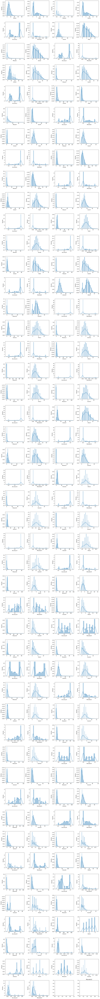

In [32]:
plot_dist(train_drop_Q)

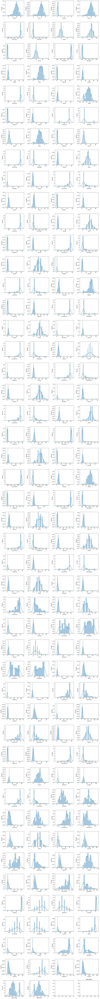

In [33]:
plot_dist(test_drop_Q)

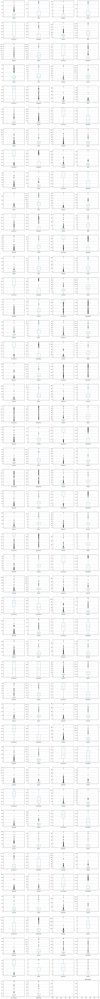

In [34]:
plot_box_whisker(train_drop_Q)

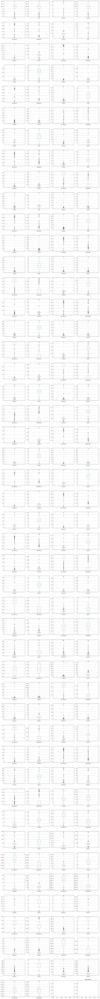

In [35]:
plot_box_whisker(test_drop_Q)

##### Zero

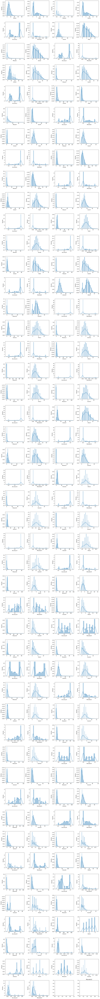

In [36]:
plot_dist(train_zero_Q)

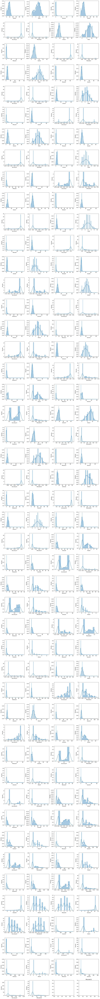

In [37]:
plot_dist(test_zero_Q)

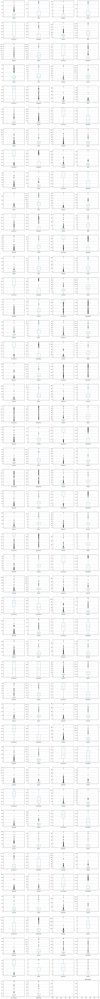

In [38]:
plot_box_whisker(train_zero_Q)

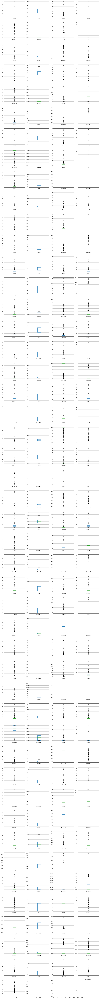

In [39]:
plot_box_whisker(test_zero_Q)

#####  Mean

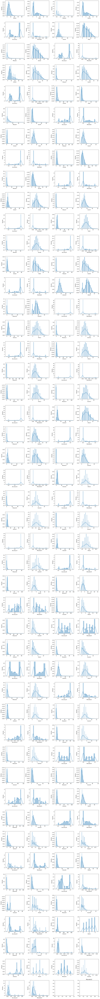

In [40]:
plot_dist(train_mean_Q)

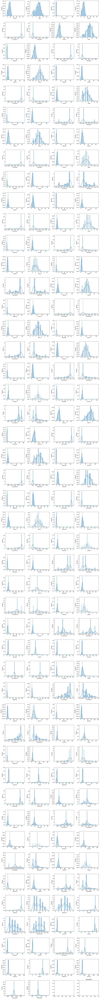

In [41]:
plot_dist(test_mean_Q)

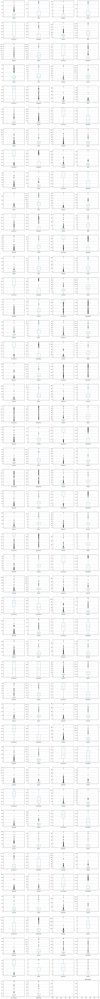

In [42]:
plot_box_whisker(train_mean_Q)

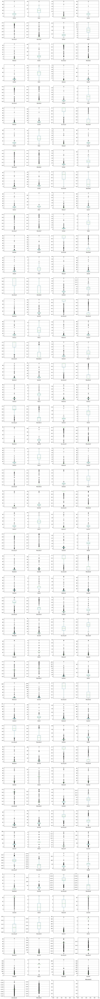

In [43]:
plot_box_whisker(test_mean_Q)

##### Median

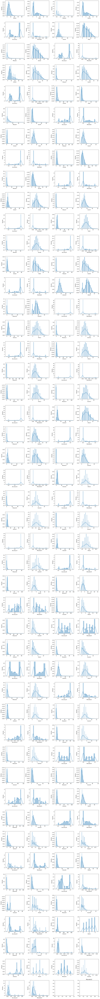

In [44]:
plot_dist(train_median_Q)

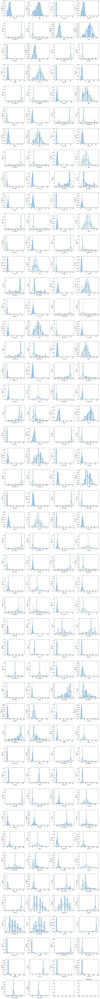

In [45]:
plot_dist(test_median_Q)

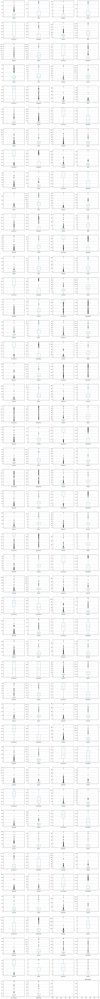

In [46]:
plot_box_whisker(train_median_Q)

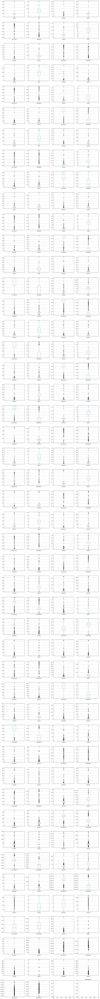

In [47]:
plot_box_whisker(test_median_Q)

### Percentile method

Para la eleminación de outliers existen varias técnicas, como Z-score method, Inter Quartile Range Method o Percentile method. La técnica que se ha elegido es el método de percentil ya que es fácil de entender y aplicar, y no requiere de una distribución específica. Como se ha podido observar, no todas las variables tienen la misma distribución, lo que podría suponer un problema utilizando Z-score o el método del Intercuartil.

Se trata de un método robusto a la presencia de valores atípicos en los datos, lo que lo hace menos propenso a ser afectado por ellos, y permite ajustar los límites al dataset con el que se esté trabajando. En este caso, para no prescindir de un gran número de datos, aun eliminando aquellos datos que influían negativamente al modelo, se han establecido como umbral superior el 0.999 e inferior el 0.001.

In [35]:
def remove_outliers(ds):
    print("Old Shape: ", ds.shape)
    
    rng = ds.columns
    for col in rng:
        #first percentile
        min_threshold = ds[col].quantile(0.001)
        #third percentile
        max_threshold = ds[col].quantile(0.999)
        
        ds.drop(ds[(ds[col] < min_threshold) | (ds[col] > max_threshold)].index, inplace=True)
        
    print("New Shape: ", ds.shape)

In [36]:
#1 DROP
print("DROP")
remove_outliers(train_drop_Q) 
remove_outliers(test_drop_Q)

#2 ZEROS
print("ZEROS")
remove_outliers(train_zero_Q)
remove_outliers(test_zero_Q)
#3.1 MEAN
print("MEAN")
remove_outliers(train_mean_Q)
remove_outliers(test_mean_Q) 
#3.2 MEDIAN
print("MEDIAN")
remove_outliers(train_median_Q) 
remove_outliers(test_median_Q)

DROP
Old Shape:  (2101, 186)
New Shape:  (1902, 186)
Old Shape:  (236, 186)
New Shape:  (50, 186)
ZEROS
Old Shape:  (2101, 186)
New Shape:  (1902, 186)
Old Shape:  (874, 186)
New Shape:  (785, 186)
MEAN
Old Shape:  (2101, 186)
New Shape:  (1902, 186)
Old Shape:  (874, 186)
New Shape:  (774, 186)
MEDIAN
Old Shape:  (2101, 186)
New Shape:  (1902, 186)
Old Shape:  (874, 186)
New Shape:  (774, 186)


Representando de nuevo los gráficos de distribución se puede observar como la presencia de outliers ha disminuido considerablemente:

##### DROP

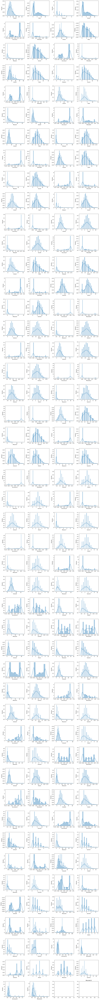

In [50]:
plot_dist(train_drop_Q)

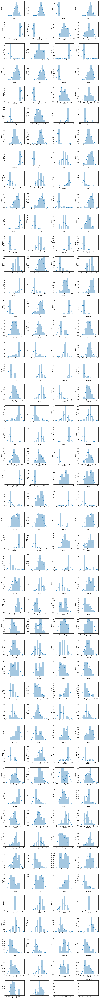

In [51]:
plot_dist(test_drop_Q)

##### ZERO

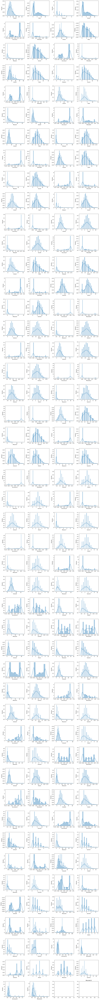

In [52]:
plot_dist(train_zero_Q)

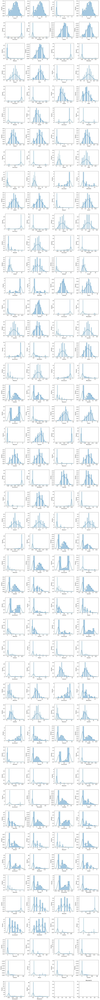

In [53]:
plot_dist(test_zero_Q)

##### MEAN

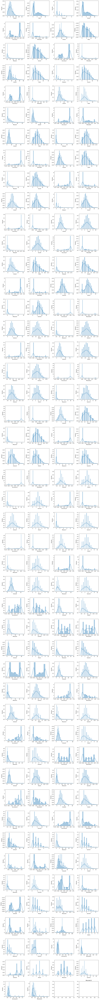

In [54]:
plot_dist(train_mean_Q)

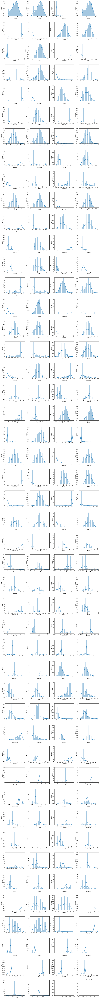

In [55]:
plot_dist(test_mean_Q)

##### MEDIAN

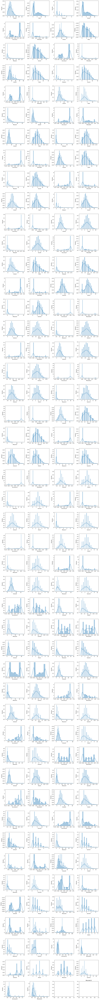

In [56]:
plot_dist(train_median_Q)

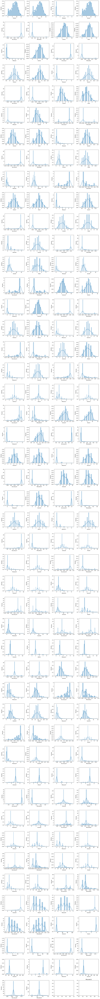

In [57]:
plot_dist(test_median_Q)

### Selección de características

Se eliminan aquellas filas que contienen valores anómalos de los datasets inciales, recuperando las columnas: 'Gender', 'Nativelang', 'Otherlang', 'Age', 'Dyslexia'

In [37]:
#1 DROP
train_drop = train_drop.loc[train_drop_Q.index]
test_drop = test_drop.loc[test_drop_Q.index]
#2 ZEROS
train_zero = train_zero.loc[train_zero_Q.index]
test_zero = test_zero.loc[test_zero_Q.index]
#3.1 MEAN
train_mean = train_mean.loc[train_mean_Q.index]
test_mean = test_mean.loc[test_mean_Q.index]
#3.2 MEDIAN
train_median = train_median.loc[train_median_Q.index]
test_median = test_median.loc[test_median_Q.index]

Se van a definir dos funciones nuevas, `corr_hit_miss`y `corr_acc_missrate`, para comparar como de correladas están las variables *Clicks*, *Hits*, *Misses* y *Score* y la suma de las variables *Hits y Misses* con *Clicks*.

In [38]:
def corr_hit_miss(ds_orig, nombre):
    ds = ds_orig.copy() 
    print(nombre+" dataset")
    for i in range(32):
        try:        
            print("Question", str(i+1))
            #Pearson correlation coef
            correlation_misses = ds['Clicks'+str(i+1)].corr(ds['Misses'+str(i+1)])
            correlation_hits = ds['Clicks'+str(i+1)].corr(ds['Hits'+str(i+1)])
            correlation_score = ds['Clicks'+str(i+1)].corr(ds['Score'+str(i+1)])

            ds['Hits + Misses'+str(i+1)] = ds['Hits'+str(i+1)] + ds['Misses'+str(i+1)]
            correlation_sum = ds['Clicks'+str(i+1)].corr(ds['Hits + Misses'+str(i+1)])

            print("Misses", str(i+1), correlation_misses)
            print("Hits", str(i+1), correlation_hits)
            print("Score", str(i+1), correlation_score)
            print("Hits + Misses", str(i+1), correlation_sum)
        except KeyError:
            print("Question "+str(i+1)+" not in the dataset")
            
    print("\n")

In [39]:
def corr_acc_missrate(ds_orig, nombre):
    ds = ds_orig.copy()
    print(nombre+" dataset")
    for i in  range(32):
        try:
            print("Question"+str(i+1))
            #Pearson correlation coeff
            correlation_acc = ds['Hits'+str(i+1)].corr(ds['Accuracy'+str(i+1)])
            correlation_missrate = ds['Misses'+str(i+1)].corr(ds['Missrate'+str(i+1)])
            correlation_accs_rate = ds['Accuracy'+str(i+1)].corr(ds['Missrate'+str(i+1)])
            
            ds['Hits / Clicks'+str(i+1)] = ds['Hits'+str(i+1)] / ds['Clicks'+str(i+1)]
            correlation_div_acc = ds['Accuracy'+str(i+1)].corr(ds['Hits / Clicks'+str(i+1)])
            
            ds['Misses / Clicks'+str(i+1)] = ds['Misses'+str(i+1)] / ds['Clicks'+str(i+1)]
            correlation_div_miss = ds['Missrate'+str(i+1)].corr(ds['Misses / Clicks'+str(i+1)])
            
            print("Accuracy"+str(i+1),correlation_acc)
            print("Missrate"+str(i+1),correlation_missrate)
            print("Between Accuracy and Missrate",correlation_accs_rate)
            print("Accuracy and Hits/Clicks"+str(i+1),correlation_div_acc)
            print("Missrate and Misses/Clicks"+str(i+1),correlation_div_miss)
            
        except KeyError:
            print("Question "+str(i+1)+" not in the dataset")
            
    print("\n")

Se comprobará tanto para los dataset de entrenamiento, como de prueba y diferenciando entre los cuatro casos distintos tras aplicar las técnicas de gestión de outliers

In [40]:
#1 DROP
print("DROP")
corr_hit_miss(train_drop, "Train")
corr_hit_miss(test_drop, "Test")
#2 ZEROS
print("ZEROS")
corr_hit_miss(train_zero, "Train")
corr_hit_miss(test_zero, "Test")
#3.1 MEAN
print("MEAN")
corr_hit_miss(train_mean, "Train")
corr_hit_miss(test_mean, "Test")
#3.2 MEDIAN
print("MEDIAN")
corr_hit_miss(train_median, "Train")
corr_hit_miss(test_median, "Test")

DROP
Train dataset
Question 1
Misses 1 0.13034715693961935
Hits 1 0.7340699292775383
Score 1 0.7314855169550101
Hits + Misses 1 0.8387291581106294
Question 2
Misses 2 0.19088942874632156
Hits 2 0.2626034833073093
Score 2 0.2739277594621481
Hits + Misses 2 0.38366740783337416
Question 3
Misses 3 0.22862080845650237
Hits 3 0.007456904749415603
Score 3 0.04487591079686741
Hits + Misses 3 0.08579940211977449
Question 4
Misses 4 0.592600315659406
Hits 4 0.6650014730626346
Score 4 0.6339113185997792
Hits + Misses 4 0.9999999999999999
Question 5
Misses 5 0.4430362984141162
Hits 5 0.730813811855061
Score 5 0.7237755297775068
Hits + Misses 5 1.0
Question 6
Misses 6 0.11637330007626598
Hits 6 0.8460560901053543
Score 6 0.8460560901053543
Hits + Misses 6 1.0
Question 7
Misses 7 0.06786577254276109
Hits 7 0.9598010469374231
Score 7 0.959248651042055
Hits + Misses 7 1.0
Question 8
Misses 8 0.36057517196002387
Hits 8 0.7620627829379611
Score 8 0.7594538490894428
Hits + Misses 8 1.0
Question 9
Misses

Misses 20 0.6830640620478945
Hits 20 0.5039024095805201
Score 20 0.5021875512324376
Hits + Misses 20 1.0
Question 21
Misses 21 0.8174671036089021
Hits 21 0.2552932838121241
Score 21 0.2531848231448813
Hits + Misses 21 0.9999999999999999
Question 22
Misses 22 0.42730205155706513
Hits 22 0.7500536663432704
Score 22 0.7487962551888516
Hits + Misses 22 1.0
Question 23
Misses 23 0.5823669819385412
Hits 23 0.7602130122817158
Score 23 0.7567037788846961
Hits + Misses 23 0.9999999999999998
Question 24
Misses 24 0.7132338499309144
Hits 24 0.4358206266292055
Score 24 0.4352891083675357
Hits + Misses 24 1.0
Question 25
Misses 25 0.636430943295634
Hits 25 0.6345698233722494
Score 25 0.6291641931067692
Hits + Misses 25 0.9999999999999998
Question 26
Misses 26 0.46966875550663
Hits 26 0.7829055822241457
Score 26 0.7653392756459186
Hits + Misses 26 1.0
Question 27
Misses 27 0.13653685329148796
Hits 27 0.5733132392807218
Score 27 0.5674425459959056
Hits + Misses 27 0.38810600196484096
Question 28
Miss

Misses 2 -0.1235043600624154
Hits 2 0.9591312925996734
Score 2 1.0
Hits + Misses 2 1.0
Question 3
Misses 3 -0.18157752284905512
Hits 3 0.9432247074039057
Score 3 1.0
Hits + Misses 3 1.0
Question 4
Misses 4 0.5485637332842358
Hits 4 0.3601391727606471
Score 4 1.0
Hits + Misses 4 1.0
Question 5
Misses 5 -0.1421919997100363
Hits 5 0.9109154119828546
Score 5 1.0
Hits + Misses 5 1.0
Question 6
Misses 6 0.3453491839669084
Hits 6 0.7165754142538986
Score 6 1.0
Hits + Misses 6 1.0
Question 7
Misses 7 -0.06296162159203054
Hits 7 0.9660120281786782
Score 7 1.0
Hits + Misses 7 1.0
Question 8
Misses 8 0.09210206517663835
Hits 8 0.9144544961309855
Score 8 1.0
Hits + Misses 8 1.0
Question 9
Misses 9 0.5019509473894621
Hits 9 0.5791570218727371
Score 9 0.9999999999999999
Hits + Misses 9 0.9999999999999999
Question 10
Misses 10 -0.03643311914632227
Hits 10 0.8603387713730972
Score 10 1.0
Hits + Misses 10 1.0
Question 11
Misses 11 0.17828907464260965
Hits 11 0.8249646602775308
Score 11 1.0
Hits + Misse

In [41]:
#1 DROP
print("DROP")
corr_acc_missrate(train_drop, "Train")
corr_acc_missrate(test_drop, "Test")
#2 ZEROS
print("ZEROS")
corr_acc_missrate(train_zero, "Train")
corr_acc_missrate(test_zero, "Test")
#3.1 MEAN
print("MEAN")
corr_acc_missrate(train_mean, "Train")
corr_acc_missrate(test_mean, "Test")
#3.2 MEDIAN
print("MEDIAN")
corr_acc_missrate(train_median, "Train")
corr_acc_missrate(test_median, "Test")

DROP
Train dataset
Question1
Accuracy1 0.749973160461039
Missrate1 0.7643101325314843
Between Accuracy and Missrate -0.697826637983648
Accuracy and Hits/Clicks1 0.9999998934872829
Missrate and Misses/Clicks1 0.9999995933848744
Question2
Accuracy2 0.7796012952882481
Missrate2 0.819428144495789
Between Accuracy and Missrate -0.5289019670211059
Accuracy and Hits/Clicks2 0.9999998796111833
Missrate and Misses/Clicks2 0.9999995457174243
Question3
Accuracy3 0.7702004517754399
Missrate3 0.7562007709881885
Between Accuracy and Missrate -0.3551909842055656
Accuracy and Hits/Clicks3 0.9999997865481633
Missrate and Misses/Clicks3 0.9999988713613109
Question4
Accuracy4 0.5044055010930331
Missrate4 0.8213405420279891
Between Accuracy and Missrate -0.9398026161249768
Accuracy and Hits/Clicks4 0.9999997261232816
Missrate and Misses/Clicks4 0.9999997261232983
Question5
Accuracy5 0.6766952649124864
Missrate5 0.6164909681002462
Between Accuracy and Missrate -0.894897423163511
Accuracy and Hits/Clicks5 0

Accuracy23 0.39498274196292454
Missrate23 0.9003266437503117
Between Accuracy and Missrate -1.0
Accuracy and Hits/Clicks23 1.0
Missrate and Misses/Clicks23 0.9999999999999994
Question24
Accuracy24 0.08841536466165781
Missrate24 0.9521037312625527
Between Accuracy and Missrate -1.0
Accuracy and Hits/Clicks24 0.9999999999999999
Missrate and Misses/Clicks24 1.0
Question25
Accuracy25 0.5955985394433406
Missrate25 0.8553001095682098
Between Accuracy and Missrate -1.0
Accuracy and Hits/Clicks25 1.0
Missrate and Misses/Clicks25 1.0
Question26
Accuracy26 0.4699700435988266
Missrate26 0.7887026470108723
Between Accuracy and Missrate -1.0
Accuracy and Hits/Clicks26 0.9999999999999999
Missrate and Misses/Clicks26 0.9999999999999999
Question27
Accuracy27 0.7415759586889157
Missrate27 0.9329060745256136
Between Accuracy and Missrate -0.6244229678464995
Accuracy and Hits/Clicks27 1.0
Missrate and Misses/Clicks27 1.0
Question28
Accuracy28 0.6549972344673468
Missrate28 0.8809939769526038
Between Accur

Accuracy24 0.8641174165745042
Missrate24 0.820257485956464
Between Accuracy and Missrate -0.06683875147497045
Accuracy and Hits/Clicks24 1.0
Missrate and Misses/Clicks24 1.0
Question25
Accuracy25 0.9431380192700984
Missrate25 0.9229965428457343
Between Accuracy and Missrate 0.3753025302744155
Accuracy and Hits/Clicks25 1.0
Missrate and Misses/Clicks25 1.0
Question26
Accuracy26 0.846498623364807
Missrate26 0.8080243614286307
Between Accuracy and Missrate 0.14958422093162047
Accuracy and Hits/Clicks26 0.9999999999999998
Missrate and Misses/Clicks26 0.9999999999999998
Question27
Accuracy27 0.8776558175590694
Missrate27 0.8624465670206733
Between Accuracy and Missrate -0.022997037738596977
Accuracy and Hits/Clicks27 0.9999999999999996
Missrate and Misses/Clicks27 1.0
Question28
Accuracy28 0.8558352962496144
Missrate28 0.8672657810424218
Between Accuracy and Missrate -0.10501396451334491
Accuracy and Hits/Clicks28 0.9999999999999999
Missrate and Misses/Clicks28 0.999999999999999
Question29


Accuracy31 0.8506579065505178
Missrate31 0.9633900659780434
Between Accuracy and Missrate -0.9691522137882945
Accuracy and Hits/Clicks31 0.952316395648452
Missrate and Misses/Clicks31 0.9416243827302339
Question32
Accuracy32 0.8541287274915429
Missrate32 0.8744449901573979
Between Accuracy and Missrate -0.9551218901277689
Accuracy and Hits/Clicks32 0.9371491416295573
Missrate and Misses/Clicks32 0.9287155561565059


MEDIAN
Train dataset
Question1
Accuracy1 0.749973160461039
Missrate1 0.7643101325314843
Between Accuracy and Missrate -0.697826637983648
Accuracy and Hits/Clicks1 0.9999998934872829
Missrate and Misses/Clicks1 0.9999995933848744
Question2
Accuracy2 0.7796012952882481
Missrate2 0.819428144495789
Between Accuracy and Missrate -0.5289019670211059
Accuracy and Hits/Clicks2 0.9999998796111833
Missrate and Misses/Clicks2 0.9999995457174243
Question3
Accuracy3 0.7702004517754399
Missrate3 0.7562007709881885
Between Accuracy and Missrate -0.3551909842055656
Accuracy and Hits/Clicks

Accuracy31 0.8716475064558397
Missrate31 0.9749406880866403
Between Accuracy and Missrate -0.9777156873813087
Accuracy and Hits/Clicks31 0.999999999999996
Missrate and Misses/Clicks31 0.9999999999999998
Question32
Accuracy32 0.8067571433561571
Missrate32 0.8377230288939902
Between Accuracy and Missrate -0.9565243993218386
Accuracy and Hits/Clicks32 0.9996218569129307
Missrate and Misses/Clicks32 1.0




In [42]:
for i in range(32):
    columns = ['Accuracy'+str(i+1), 'Missrate'+str(i+1), 'Clicks'+str(i+1)]
    try:
        # 1 DROP
        train_drop = train_drop.drop(columns, axis=1)
        test_drop = test_drop.drop(columns, axis=1)

        # 2 ZEROS
        train_zero = train_zero.drop(columns, axis=1)
        test_zero = test_zero.drop(columns, axis=1)

        # 3.1 MEAN
        train_mean = train_mean.drop(columns, axis=1)
        test_mean = test_mean.drop(columns, axis=1)

        # 3.2 MEDIAN
        train_median = train_median.drop(columns, axis=1)
        test_median = test_median.drop(columns, axis=1)
    except KeyError:
        print("Colmuns not found: ",columns)

Colmuns not found:  ['Accuracy29', 'Missrate29', 'Clicks29']


In [43]:
train_drop.head()

,Gender,Nativelang,Otherlang,Age,Hits1,Misses1,Score1,Hits2,Misses2,Score2,Hits3,Misses3,Score3,Hits4,Misses4,Score4,Hits5,Misses5,Score5,Hits6,Misses6,Score6,Hits7,Misses7,Score7,Hits8,Misses8,Score8,Hits9,Misses9,Score9,Hits10,Misses10,Score10,Hits11,Misses11,Score11,Hits12,Misses12,Score12,Hits13,Misses13,Score13,Hits14,Misses14,Score14,Hits15,Misses15,Score15,Hits16,Misses16,Score16,Hits17,Misses17,Score17,Hits18,Misses18,Score18,Hits19,Misses19,Score19,Hits20,Misses20,Score20,Hits21,Misses21,Score21,Hits22,Misses22,Score22,Hits23,Misses23,Score23,Hits24,Misses24,Score24,Hits25,Misses25,Score25,Hits26,Misses26,Score26,Hits27,Misses27,Score27,Hits28,Misses28,Score28,Hits30,Misses30,Score30,Hits31,Misses31,Score31,Hits32,Misses32,Score32,Dyslexia
0,0.0,0.0,1.0,7.0,10.0,0.0,10.0,5.0,0.0,5.0,6.0,0.0,6.0,2.0,0.0,2.0,3.0,0.0,3.0,1.0,3.0,1.0,5.0,0.0,5.0,3.0,1.0,3.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,2.0,1.0,3.0,0.0,3.0,3.0,0.0,3.0,4.0,0.0,4.0,2.0,0.0,2.0,2.0,0.0,2.0,3.0,0.0,3.0,2.0,0.0,2.0,3.0,1.0,3.0,1.0,4.0,1.0,1.0,2.0,1.0,1.0,3.0,1.0,3.0,1.0,3.0,2.0,1.0,2.0,3.0,0.0,3.0,3.0,2.0,3.0,1.0,1.0,1.0,2.0,0.0,2.0,1.0,2.0,1.0,0.0,0.0,0.0,2.0,0.0,2.0,0.0
2,1.0,0.0,1.0,7.0,6.0,0.0,6.0,6.0,0.0,6.0,6.0,0.0,6.0,3.0,0.0,3.0,4.0,0.0,4.0,2.0,0.0,2.0,5.0,2.0,5.0,3.0,2.0,3.0,3.0,0.0,3.0,5.0,2.0,5.0,5.0,1.0,5.0,6.0,0.0,6.0,3.0,0.0,3.0,6.0,0.0,6.0,3.0,0.0,3.0,4.0,0.0,4.0,2.0,0.0,2.0,1.0,1.0,1.0,4.0,1.0,4.0,1.0,5.0,1.0,3.0,3.0,3.0,5.0,1.0,5.0,3.0,2.0,3.0,3.0,1.0,3.0,4.0,1.0,4.0,2.0,3.0,2.0,2.0,1.0,2.0,3.0,1.0,3.0,1.0,3.0,1.0,4.0,0.0,4.0,1.0,3.0,1.0,0.0
5,1.0,0.0,1.0,8.0,9.0,0.0,9.0,8.0,0.0,8.0,3.0,0.0,3.0,2.0,1.0,2.0,5.0,0.0,5.0,3.0,2.0,3.0,3.0,1.0,3.0,4.0,0.0,4.0,3.0,0.0,3.0,4.0,1.0,4.0,4.0,0.0,4.0,2.0,0.0,2.0,2.0,0.0,2.0,3.0,1.0,3.0,3.0,0.0,3.0,4.0,0.0,4.0,3.0,1.0,3.0,2.0,2.0,2.0,1.0,2.0,1.0,1.0,3.0,1.0,1.0,2.0,1.0,4.0,1.0,4.0,4.0,3.0,4.0,2.0,2.0,2.0,3.0,2.0,3.0,5.0,2.0,5.0,2.0,1.0,2.0,3.0,1.0,3.0,2.0,2.0,2.0,3.0,0.0,3.0,2.0,1.0,2.0,0.0
6,1.0,0.0,1.0,8.0,6.0,0.0,6.0,8.0,0.0,8.0,8.0,0.0,8.0,3.0,0.0,3.0,7.0,0.0,7.0,1.0,2.0,1.0,4.0,2.0,4.0,4.0,0.0,4.0,3.0,0.0,3.0,3.0,2.0,3.0,4.0,2.0,4.0,1.0,0.0,1.0,3.0,0.0,3.0,3.0,1.0,3.0,2.0,1.0,2.0,4.0,0.0,4.0,3.0,0.0,3.0,2.0,1.0,2.0,2.0,3.0,2.0,2.0,4.0,2.0,2.0,3.0,2.0,4.0,1.0,4.0,3.0,4.0,3.0,1.0,0.0,1.0,2.0,1.0,2.0,8.0,0.0,8.0,2.0,0.0,2.0,3.0,0.0,3.0,0.0,3.0,0.0,4.0,0.0,4.0,2.0,2.0,2.0,0.0
9,1.0,0.0,0.0,16.0,5.0,0.0,5.0,10.0,0.0,10.0,10.0,0.0,10.0,2.0,0.0,2.0,6.0,0.0,6.0,4.0,1.0,4.0,4.0,0.0,4.0,5.0,0.0,5.0,3.0,0.0,3.0,8.0,0.0,8.0,2.0,2.0,2.0,3.0,0.0,3.0,5.0,0.0,5.0,7.0,0.0,7.0,4.0,0.0,4.0,0.0,1.0,0.0,3.0,0.0,3.0,6.0,0.0,6.0,3.0,0.0,3.0,2.0,3.0,2.0,2.0,2.0,2.0,3.0,1.0,3.0,5.0,2.0,5.0,1.0,1.0,1.0,6.0,1.0,6.0,3.0,4.0,3.0,1.0,1.0,1.0,2.0,1.0,2.0,0.0,4.0,0.0,2.0,3.0,2.0,3.0,1.0,3.0,1.0


### Divide data

Tras realizar la limpieza y preparar los datos que se van a emplear para diseñar el modelo, se va a proceder con la separación entre las variables que se van a empelar para entrenar el modelo y la variable que se quiere predecir. Es decir, se va a diferenciar entre **X**, set con todas las variables excepto si una persona es disléxica o no, e **y**, set que contiene los valores corresondientes a la variable *Dyslexia*.

In [44]:
####TRAIN####
#1 DROP
y_drop = train_drop['Dyslexia']
X_drop = train_drop.loc[:, train_drop.columns != 'Dyslexia']

#2 ZEROS
y_zero = train_zero['Dyslexia']
X_zero = train_zero.loc[:, train_zero.columns != 'Dyslexia']

#3.1 MEAN
y_mean = train_mean['Dyslexia']
X_mean = train_mean.loc[:, train_mean.columns != 'Dyslexia']

#3.2 MEDIAN
y_median = train_median['Dyslexia']
X_median = train_median.loc[:, train_median.columns != 'Dyslexia']

####TEST####
#1 DROP
y_test_drop = test_drop['Dyslexia']
X_test_drop = test_drop.loc[:, test_drop.columns != 'Dyslexia']

#2 ZEROS
y_test_zero = test_zero['Dyslexia']
X_test_zero = test_zero.loc[:, test_zero.columns != 'Dyslexia']

#3.1 MEAN
y_test_mean = test_mean['Dyslexia']
X_test_mean = test_mean.loc[:, test_mean.columns != 'Dyslexia']

#3.2 MEDIAN
y_test_median = test_median['Dyslexia']
X_test_median = test_median.loc[:, test_median.columns != 'Dyslexia']

## Modeling Training

In [45]:
from sklearn import metrics
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import precision_score, recall_score
from sklearn.metrics import f1_score, jaccard_score

Se va a proceder a entrenar el modelo. Como se mencionó al inicio del documento se van a emplear cinco algoritmos distintos de Machine Learning, de los cuales se eligirá el que prediga los casos positivos y negativos.

Antes de comenzar con el entrenamiento del modelo se van a definir varias funciones con el objetivo de simplificar el código:

- `plot_confusion_matrix(cm, classes)`: toma como argumentos de entrada la matriz de confusión del modelo y los valores que se quieren evaluar, en este caso 0's y 1's. Mostrará por pantalla la representación de los aciertos y fallos comparando que casos se han predicho correctamente y cuales no.
- `knn_accuracy(X_train, y_train, X_test, y_test, Ks)`: uno de los algoritmos de Machine Learning que se va a entrenar es K-Nearest Neighbors, por lo que es necesario escoger cuidadosamente el número de clusters con el que se va a entrenar el modelo. Mediante esta función, pasando como argumentos de entrada los datos usados para el train y el test y el máximo de clusters que se quieren probar, se imprimirá por pantalla la exactitud (*accuracy*) que tiene el modelo en función de los distintos valores de k
- `k_fold_cv(X, y, n, model)`: K-fold  cross-validation se emplea como técnica de evaluación del modelo recursiva. Pasando como argumentos de entrada los datos, el modelo que se quiere testear y la cantidad de iteración que se van a realizar, la función va a dividir de diferente forma los datos n veces y calcular la media de los resultados obtenidos en cada iteración al final. Se ha especificado que devuelva la excatitud del modelo (*score*) y el F1-score de las dos clases, es decir, tanto de los 0's como de los 1's
- `evaluate_model(X_train, y_train, X_test, y_test, model)`: esta función va a devolver distintas evaluaciones del modelo, como por ejemplo *Recall*, *Accuracy*, *Jaccard index* o *F1-score*, así como la representación de la matriz de confusión del modelo que se especifique.

In [46]:
import itertools

def plot_confusion_matrix(cm, classes):
    # Create figure and axes
    fig, ax = plt.subplots()
    im = ax.imshow(cm, cmap='Blues')

    #add value count to each cell
    fmt = 'd'
    thresh = cm.max() / 3.
    
    #labels value count
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    #set axis labels
    ax.set_xticks(np.arange(len(classes)))
    ax.set_yticks(np.arange(len(classes)))
    ax.set_xticklabels(classes)
    ax.set_yticklabels(classes)
    ax.set_ylabel('True label')
    ax.set_xlabel('Predicted label')

    #colorbar
    cbar = ax.figure.colorbar(im, ax=ax)

    plt.show()

In [47]:
#calculate nº clusters KNN
def knn_accuracy(X_train, y_train, X_test, y_test, Ks):
    
    for n in range(1,Ks):
        model = KNeighborsClassifier(n_neighbors=n).fit(X_train, y_train)
        y_hat = model.predict(X_test)
        
        acc = metrics.accuracy_score(y_test, y_hat)
        print(f"Value of k: {n} - Accuracy: {acc:.2f}")

In [48]:
def k_fold_cv(X, y, n, model):
    kf = KFold(n_splits = n)
    
    X = pd.DataFrame(X)
    y = pd.DataFrame(y)
    
    #accuracy
    scores = []
    
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index].values, X.iloc[test_index].values
        y_train, y_test = y.iloc[train_index].values, y.iloc[test_index].values
        #model prediction 
        y_hat = model.predict(X_test)
        #evaluate the performance of a model (accuracy score)
        score = model.score(X_test,y_test)
        scores.append(score)
        
    
    return "Accuracy: "+str(np.mean(scores))

In [49]:
def evaluate_model(X_train, y_train, X_test, y_test, model):
    
    y_hat = model.predict(X_test)
    
    #different evaluations
    print("Train set Accuracy: ", metrics.accuracy_score(y_train, model.predict(X_train)))
    print("Test set Accuracy: ", metrics.accuracy_score(y_test, y_hat))
    '''
    print("Recall 0's: ", recall_score(y_test, y_hat, pos_label=0))
    print("Recall 1's: ", recall_score(y_test, y_hat, pos_label=1))
    print("F1 score 0's: ", f1_score(y_test, y_hat, pos_label=0))
    print("F1 score 1's: ", f1_score(y_test, y_hat, pos_label=1))
    '''
    print("Jaccard index 0's: ", jaccard_score(y_test, y_hat, pos_label = 0))
    print("Jaccard index 1's: ", jaccard_score(y_test, y_hat, pos_label = 1))
    print("\n")
    
    #classification report
    print (classification_report(y_test, y_hat))
    print("\n")

    #compute confusion matrix
    cm = confusion_matrix(y_test, y_hat, labels=[0,1])
    np.set_printoptions(precision = 2)

    #plot confusion matrix
    plt.figure()
    plot_confusion_matrix(cm, classes=['No = 0','Yes = 1'])

## 1. K-Nearest Neighbors

In [50]:
from sklearn.neighbors import KNeighborsClassifier

### 1.1. Drop Values

In [51]:
# Values used to train the model: X_drop, y_drop
# Values used to test the model: X_test_drop, y_test_drop

# Data Standardization -> Good practice working with KNN (based on the distance)
X_drop_KNN = preprocessing.StandardScaler().fit(X_drop).transform(X_drop.astype(float))
X_test_drop_KNN = preprocessing.StandardScaler().fit(X_test_drop).transform(X_test_drop.astype(float))

In [52]:
knn_accuracy(X_drop_KNN, y_drop, X_test_drop_KNN, y_test_drop, 10)

Value of k: 1 - Accuracy: 0.74
Value of k: 2 - Accuracy: 0.86
Value of k: 3 - Accuracy: 0.82
Value of k: 4 - Accuracy: 0.84
Value of k: 5 - Accuracy: 0.86
Value of k: 6 - Accuracy: 0.84
Value of k: 7 - Accuracy: 0.84
Value of k: 8 - Accuracy: 0.84
Value of k: 9 - Accuracy: 0.84


In [53]:
k = 2
#Train Model and Predict  
neigh_drop = KNeighborsClassifier(n_neighbors = k).fit(X_drop_KNN,y_drop)
y_hat_drop_KNN = neigh_drop.predict(X_test_drop_KNN)

In [54]:
k_fold_cv(X_drop_KNN, y_drop, 10, neigh_drop)

'Accuracy: 0.9043042160374759'

Train set Accuracy:  0.9043112513144059
Test set Accuracy:  0.86
Jaccard index 0's:  0.8571428571428571
Jaccard index 1's:  0.125


              precision    recall  f1-score   support

         0.0       0.86      1.00      0.92        42
         1.0       1.00      0.12      0.22         8

    accuracy                           0.86        50
   macro avg       0.93      0.56      0.57        50
weighted avg       0.88      0.86      0.81        50





<Figure size 432x288 with 0 Axes>

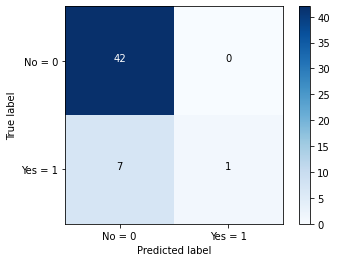

In [55]:
evaluate_model(X_drop_KNN, y_drop, X_test_drop_KNN, y_test_drop, neigh_drop)

### 1.2. Zero Values

In [54]:
# Values used to train the model: X_zero, y_zero
# Values used to test the model: X_test_zero, y_test_zero

# Data Standardization -> Good practice working with KNN (based on the distance)
X_zero_KNN = preprocessing.StandardScaler().fit(X_zero).transform(X_zero.astype(float))
X_test_zero_KNN = preprocessing.StandardScaler().fit(X_test_zero).transform(X_test_zero.astype(float))

In [55]:
knn_accuracy(X_zero_KNN, y_zero, X_test_zero_KNN, y_test_zero, 10)

Value of k: 1 - Accuracy: 0.75
Value of k: 2 - Accuracy: 0.85
Value of k: 3 - Accuracy: 0.81
Value of k: 4 - Accuracy: 0.85
Value of k: 5 - Accuracy: 0.83
Value of k: 6 - Accuracy: 0.86
Value of k: 7 - Accuracy: 0.85
Value of k: 8 - Accuracy: 0.86
Value of k: 9 - Accuracy: 0.86


In [56]:
k = 2
#Train Model and Predict  
neigh_zero = KNeighborsClassifier(n_neighbors = k).fit(X_zero_KNN,y_zero)
y_hat_zero_KNN = neigh_zero.predict(X_test_zero_KNN)

In [57]:
k_fold_cv(X_zero_KNN, y_zero, 10, neigh_zero)

'Accuracy: 0.9043042160374759'

Train set Accuracy:  0.9043112513144059
Test set Accuracy:  0.845859872611465
Jaccard index 0's:  0.8442728442728443
Jaccard index 1's:  0.06201550387596899


              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92       677
         1.0       0.28      0.07      0.12       108

    accuracy                           0.85       785
   macro avg       0.57      0.52      0.52       785
weighted avg       0.79      0.85      0.81       785





<Figure size 432x288 with 0 Axes>

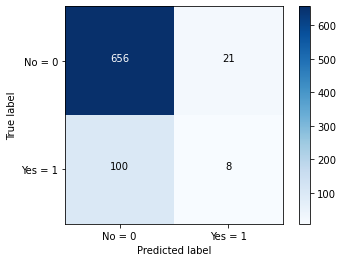

In [58]:
evaluate_model(X_zero_KNN, y_zero, X_test_zero_KNN, y_test_zero, neigh_zero)

### 1.3. Mean Values

In [59]:
# Values used to train the model: X_mean, y_mean
# Values used to test the model: X_test_mean, y_test_mean

# Data Standardization -> Good practice working with KNN (based on the distance)
X_mean_KNN = preprocessing.StandardScaler().fit(X_mean).transform(X_mean.astype(float))
X_test_mean_KNN = preprocessing.StandardScaler().fit(X_test_mean).transform(X_test_mean.astype(float))

In [60]:
knn_accuracy(X_mean_KNN, y_mean, X_test_mean_KNN, y_test_mean, 10)

Value of k: 1 - Accuracy: 0.77
Value of k: 2 - Accuracy: 0.85
Value of k: 3 - Accuracy: 0.83
Value of k: 4 - Accuracy: 0.86
Value of k: 5 - Accuracy: 0.86
Value of k: 6 - Accuracy: 0.86
Value of k: 7 - Accuracy: 0.87
Value of k: 8 - Accuracy: 0.87
Value of k: 9 - Accuracy: 0.86


In [61]:
k = 2
#Train Model and Predict  
neigh_mean = KNeighborsClassifier(n_neighbors = k).fit(X_mean_KNN,y_mean)
y_hat_mean_KNN = neigh_mean.predict(X_test_mean_KNN)

In [62]:
k_fold_cv(X_mean_KNN, y_mean, 10, neigh_mean)

'Accuracy: 0.9043042160374759'

Train set Accuracy:  0.9043112513144059
Test set Accuracy:  0.8462532299741602
Jaccard index 0's:  0.8458549222797928
Jaccard index 1's:  0.01652892561983471


              precision    recall  f1-score   support

         0.0       0.86      0.98      0.92       668
         1.0       0.12      0.02      0.03       106

    accuracy                           0.85       774
   macro avg       0.49      0.50      0.47       774
weighted avg       0.76      0.85      0.80       774





<Figure size 432x288 with 0 Axes>

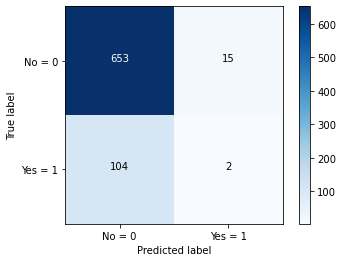

In [63]:
evaluate_model(X_mean_KNN, y_mean, X_test_mean_KNN, y_test_mean, neigh_mean)

### 1.4. Median Values

In [64]:
# Values used to train the model: X_median, y_median
# Values used to test the model: X_test_median, y_test_median

# Data Standardization -> Good practice working with KNN (based on the distance)
X_median_KNN = preprocessing.StandardScaler().fit(X_median).transform(X_median.astype(float))
X_test_median_KNN = preprocessing.StandardScaler().fit(X_test_median).transform(X_test_median.astype(float))

In [65]:
knn_accuracy(X_median_KNN, y_median, X_test_median_KNN, y_test_median, 10)

Value of k: 1 - Accuracy: 0.78
Value of k: 2 - Accuracy: 0.84
Value of k: 3 - Accuracy: 0.83
Value of k: 4 - Accuracy: 0.86
Value of k: 5 - Accuracy: 0.85
Value of k: 6 - Accuracy: 0.86
Value of k: 7 - Accuracy: 0.86
Value of k: 8 - Accuracy: 0.86
Value of k: 9 - Accuracy: 0.86


In [66]:
k = 2
#Train Model and Predict  
neigh_median = KNeighborsClassifier(n_neighbors = k).fit(X_median_KNN,y_median)
y_hat_median_KNN = neigh_median.predict(X_test_median_KNN)

In [67]:
k_fold_cv(X_median_KNN, y_median, 10, neigh_median)

'Accuracy: 0.9043042160374759'

Train set Accuracy:  0.9043112513144059
Test set Accuracy:  0.8449612403100775
Jaccard index 0's:  0.8447606727037517
Jaccard index 1's:  0.008264462809917356


              precision    recall  f1-score   support

         0.0       0.86      0.98      0.92       668
         1.0       0.06      0.01      0.02       106

    accuracy                           0.84       774
   macro avg       0.46      0.49      0.47       774
weighted avg       0.75      0.84      0.79       774





<Figure size 432x288 with 0 Axes>

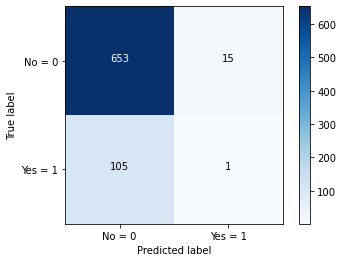

In [68]:
evaluate_model(X_median_KNN, y_median, X_test_median_KNN, y_test_median, neigh_median)

## 2. Logistic Regression

In [69]:
from sklearn.linear_model import LogisticRegression

### 2.1. Drop Values

In [70]:
# Values used to train the model: X_drop, y_drop
# Values used to test the model: X_test_drop, y_test_drop

# Data Standardization (algorithm based on the distance)
X_drop_LR = preprocessing.StandardScaler().fit(X_drop).transform(X_drop.astype(float))
X_test_drop_LR = preprocessing.StandardScaler().fit(X_test_drop).transform(X_test_drop.astype(float))

In [101]:
# Train Model and Predict  
LR_drop = LogisticRegression(solver='newton-cg').fit(X_drop_LR,y_drop)
y_hat_drop_LR = LR_drop.predict(X_test_drop_LR)

# Predict the probability of each class for a given input
y_hat_prob_drop_LR = LR_drop.predict_proba(X_test_drop_LR)

In [102]:
k_fold_cv(X_drop_LR, y_drop, 10, LR_drop)

'Accuracy: 0.896930283824745'

Train set Accuracy:  0.8969505783385909
Test set Accuracy:  0.78
Jaccard index 0's:  0.78
Jaccard index 1's:  0.0


              precision    recall  f1-score   support

         0.0       0.83      0.93      0.88        42
         1.0       0.00      0.00      0.00         8

    accuracy                           0.78        50
   macro avg       0.41      0.46      0.44        50
weighted avg       0.70      0.78      0.74        50





<Figure size 432x288 with 0 Axes>

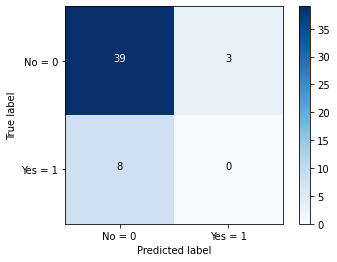

In [103]:
evaluate_model(X_drop_LR, y_drop, X_test_drop_LR, y_test_drop, LR_drop)

### 2.2. Zero Values

In [90]:
# Values used to train the model: X_zero, y_zero
# Values used to test the model: X_test_zero, y_test_zero

# Data Standardization (algorithm based on the distance)
X_zero_LR = preprocessing.StandardScaler().fit(X_zero).transform(X_zero.astype(float))
X_test_zero_LR = preprocessing.StandardScaler().fit(X_test_zero).transform(X_test_zero.astype(float))

In [99]:
# Train Model and Predict  
LR_zero = LogisticRegression(solver='newton-cg').fit(X_zero_LR,y_zero)
y_hat_zero_LR = LR_zero.predict(X_test_zero_LR)

# Predict the probability of each class for a given input
y_hat_prob_zero_LR = LR_zero.predict_proba(X_test_zero_LR)

Train set Accuracy:  0.8969505783385909
Test set Accuracy:  0.8305732484076433
Jaccard index 0's:  0.8290488431876607
Jaccard index 1's:  0.05


              precision    recall  f1-score   support

         0.0       0.86      0.95      0.91       677
         1.0       0.18      0.06      0.10       108

    accuracy                           0.83       785
   macro avg       0.52      0.51      0.50       785
weighted avg       0.77      0.83      0.79       785





<Figure size 432x288 with 0 Axes>

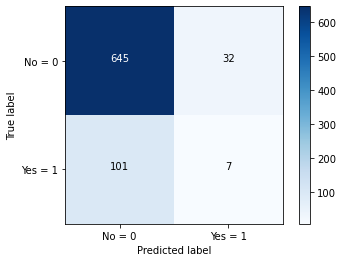

In [100]:
evaluate_model(X_zero_LR, y_zero, X_test_zero_LR, y_test_zero, LR_zero)

### 2.3. Mean Values

In [106]:
# Values used to train the model: X_mean, y_mean
# Values used to test the model: X_test_mean, y_test_mean

# Data Standardization (algorithm based on the distance)
X_mean_LR = preprocessing.StandardScaler().fit(X_mean).transform(X_mean.astype(float))
X_test_mean_LR = preprocessing.StandardScaler().fit(X_test_mean).transform(X_test_mean.astype(float))

In [113]:
# Train Model and Predict  
LR_mean = LogisticRegression(C=0.01, solver='liblinear').fit(X_mean_LR,y_mean)
y_hat_mean_LR = LR_mean.predict(X_test_mean_LR)

# Predict the probability of each class for a given input
y_hat_prob_mean_LR = LR_mean.predict_proba(X_test_mean_LR)

Train set Accuracy:  0.8948475289169295
Test set Accuracy:  0.8229974160206718
Jaccard index 0's:  0.8194993412384717
Jaccard index 1's:  0.09868421052631579


              precision    recall  f1-score   support

         0.0       0.87      0.93      0.90       668
         1.0       0.25      0.14      0.18       106

    accuracy                           0.82       774
   macro avg       0.56      0.54      0.54       774
weighted avg       0.79      0.82      0.80       774





<Figure size 432x288 with 0 Axes>

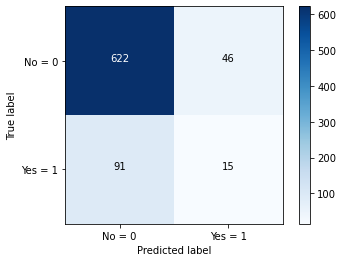

In [114]:
evaluate_model(X_mean_LR, y_mean, X_test_mean_LR, y_test_mean, LR_mean)

### 2.4. Median Values

In [115]:
# Values used to train the model: X_median, y_median
# Values used to test the model: X_test_median, y_test_median

# Data Standardization (algorithm based on the distance)
X_median_LR = preprocessing.StandardScaler().fit(X_median).transform(X_median.astype(float))
X_test_median_LR = preprocessing.StandardScaler().fit(X_test_median).transform(X_test_median.astype(float))

In [116]:
# Train Model and Predict  
LR_median = LogisticRegression(C=0.01, solver='liblinear').fit(X_median_LR,y_median)
y_hat_median_LR = LR_median.predict(X_test_median_LR)

# Predict the probability of each class for a given input
y_hat_prob_median_LR = LR_median.predict_proba(X_test_median_LR)

Train set Accuracy:  0.8948475289169295
Test set Accuracy:  0.8359173126614987
Jaccard index 0's:  0.8335517693315858
Jaccard index 1's:  0.07971014492753623


              precision    recall  f1-score   support

         0.0       0.87      0.95      0.91       668
         1.0       0.26      0.10      0.15       106

    accuracy                           0.84       774
   macro avg       0.56      0.53      0.53       774
weighted avg       0.79      0.84      0.80       774





<Figure size 432x288 with 0 Axes>

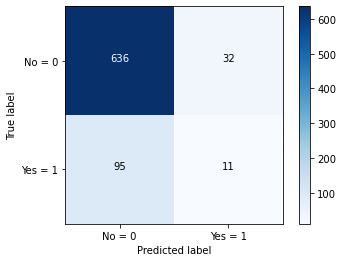

In [117]:
evaluate_model(X_median_LR, y_median, X_test_median_LR, y_test_median, LR_median)

## 3. Support Vector Machines

In [56]:
from sklearn import svm

In [57]:
# Model: svm.SVC(kernel='rbf')
# kernel='rbf'" where 'rbf' stands for radial basis function

### 3.1. Drop Values

In [58]:
# Values used to train the model: X_drop, y_drop
# Values used to test the model: X_test_drop, y_test_drop

# Train Model and Predict 
svm_drop = svm.SVC(kernel='rbf').fit(X_drop, y_drop) 
y_hat_drop_SVM = svm_drop.predict(X_test_drop)

Train set Accuracy:  0.8769716088328076
Test set Accuracy:  0.84
Jaccard index 0's:  0.84
Jaccard index 1's:  0.0


              precision    recall  f1-score   support

         0.0       0.84      1.00      0.91        42
         1.0       0.00      0.00      0.00         8

    accuracy                           0.84        50
   macro avg       0.42      0.50      0.46        50
weighted avg       0.71      0.84      0.77        50





<Figure size 432x288 with 0 Axes>

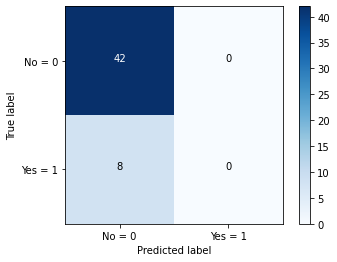

In [59]:
evaluate_model(X_drop, y_drop, X_test_drop, y_test_drop, svm_drop)

### 3.2. Zero Values

In [60]:
# Values used to train the model: X_zero, y_zero
# Values used to test the model: X_test_zero, y_test_zero

# Train Model and Predict  
svm_zero = svm.SVC(kernel='rbf').fit(X_zero, y_zero) 
y_hat_zero_SVM = svm_zero.predict(X_test_zero)

Train set Accuracy:  0.8769716088328076
Test set Accuracy:  0.8585987261146497
Jaccard index 0's:  0.8584183673469388
Jaccard index 1's:  0.008928571428571428


              precision    recall  f1-score   support

         0.0       0.86      0.99      0.92       677
         1.0       0.20      0.01      0.02       108

    accuracy                           0.86       785
   macro avg       0.53      0.50      0.47       785
weighted avg       0.77      0.86      0.80       785





<Figure size 432x288 with 0 Axes>

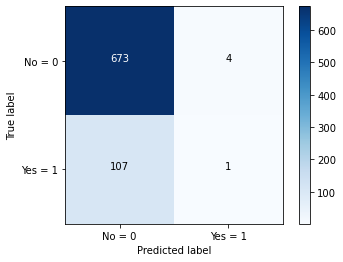

In [61]:
evaluate_model(X_zero, y_zero, X_test_zero, y_test_zero, svm_zero)

### 3.3. Mean Values

In [62]:
# Values used to train the model: X_mean, y_mean
# Values used to test the model: X_test_mean, y_test_mean

# Train Model and Predict  
svm_mean = svm.SVC(kernel='rbf').fit(X_mean, y_mean) 
y_hat_mean_SVM = svm_mean.predict(X_test_mean)

Train set Accuracy:  0.8769716088328076
Test set Accuracy:  0.8630490956072352
Jaccard index 0's:  0.8630490956072352
Jaccard index 1's:  0.0


              precision    recall  f1-score   support

         0.0       0.86      1.00      0.93       668
         1.0       0.00      0.00      0.00       106

    accuracy                           0.86       774
   macro avg       0.43      0.50      0.46       774
weighted avg       0.74      0.86      0.80       774





<Figure size 432x288 with 0 Axes>

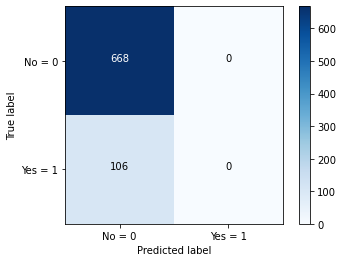

In [63]:
evaluate_model(X_mean, y_mean, X_test_mean, y_test_mean, svm_mean)

### 3.4. Median Values

In [64]:
# Values used to train the model: X_median, y_median
# Values used to test the model: X_test_median, y_test_median

# Train Model and Predict  
svm_median = svm.SVC(kernel='rbf').fit(X_median, y_median) 
y_hat_median_SVM = svm_median.predict(X_test_median)

Train set Accuracy:  0.8769716088328076
Test set Accuracy:  0.8630490956072352
Jaccard index 0's:  0.8630490956072352
Jaccard index 1's:  0.0


              precision    recall  f1-score   support

         0.0       0.86      1.00      0.93       668
         1.0       0.00      0.00      0.00       106

    accuracy                           0.86       774
   macro avg       0.43      0.50      0.46       774
weighted avg       0.74      0.86      0.80       774





<Figure size 432x288 with 0 Axes>

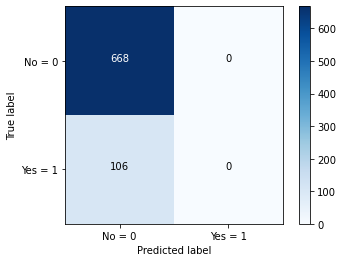

In [65]:
evaluate_model(X_median, y_median, X_test_median, y_test_median, svm_median)

## 4. Random Forest

In [66]:
from sklearn.ensemble import RandomForestClassifier

### 4.1. Drop Values

In [67]:
# Values used to train the model: X_drop, y_drop
# Values used to test the model: X_test_drop, y_test_drop

# Train Model and Predict 
rfc_drop = RandomForestClassifier(n_estimators = 30, max_depth = 7, min_samples_leaf = 6).fit(X_drop , y_drop)
y_hat_drop_RF = rfc_drop.predict(X_test_drop)

Train set Accuracy:  0.8727655099894848
Test set Accuracy:  0.84
Jaccard index 0's:  0.84
Jaccard index 1's:  0.0


              precision    recall  f1-score   support

         0.0       0.84      1.00      0.91        42
         1.0       0.00      0.00      0.00         8

    accuracy                           0.84        50
   macro avg       0.42      0.50      0.46        50
weighted avg       0.71      0.84      0.77        50





<Figure size 432x288 with 0 Axes>

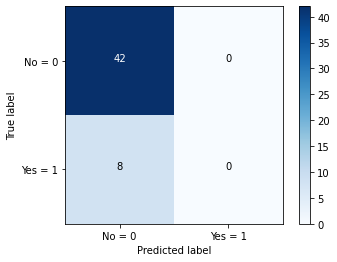

In [68]:
evaluate_model(X_drop, y_drop, X_test_drop, y_test_drop, rfc_drop)

### 4.2. Zero Values

In [69]:
# Values used to train the model: X_zero, y_zero
# Values used to test the model: X_test_zero, y_test_zero

# Train Model and Predict  
rfc_zero = RandomForestClassifier(n_estimators = 30, max_depth = 7, min_samples_leaf = 6).fit(X_zero , y_zero)
y_hat_zero_RF = rfc_zero.predict(X_test_zero)

Train set Accuracy:  0.8785488958990536
Test set Accuracy:  0.8649681528662421
Jaccard index 0's:  0.8644501278772379
Jaccard index 1's:  0.027522935779816515


              precision    recall  f1-score   support

         0.0       0.87      1.00      0.93       677
         1.0       0.75      0.03      0.05       108

    accuracy                           0.86       785
   macro avg       0.81      0.51      0.49       785
weighted avg       0.85      0.86      0.81       785





<Figure size 432x288 with 0 Axes>

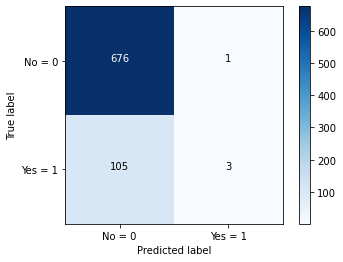

In [70]:
evaluate_model(X_zero, y_zero, X_test_zero, y_test_zero, rfc_zero)

### 4.3. Mean Values

In [71]:
# Values used to train the model: X_mean, y_mean
# Values used to test the model: X_test_mean, y_test_mean

# Train Model and Predict 
rfc_mean = RandomForestClassifier(n_estimators = 30, max_depth = 7, min_samples_leaf = 6).fit(X_mean , y_mean)
y_hat_mean_RF = rfc_mean.predict(X_test_mean)

Train set Accuracy:  0.8785488958990536
Test set Accuracy:  0.8630490956072352
Jaccard index 0's:  0.8630490956072352
Jaccard index 1's:  0.0


              precision    recall  f1-score   support

         0.0       0.86      1.00      0.93       668
         1.0       0.00      0.00      0.00       106

    accuracy                           0.86       774
   macro avg       0.43      0.50      0.46       774
weighted avg       0.74      0.86      0.80       774





<Figure size 432x288 with 0 Axes>

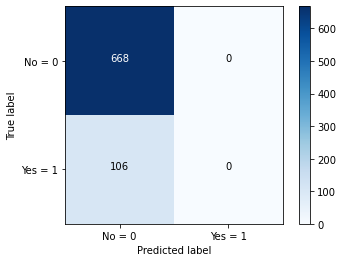

In [72]:
evaluate_model(X_mean, y_mean, X_test_mean, y_test_mean, rfc_mean)

### 4.4. Median Values

In [73]:
# Values used to train the model: X_median, y_median
# Values used to test the model: X_test_median, y_test_median

# Train Model and Predict 
rfc_median = RandomForestClassifier(n_estimators = 30, max_depth = 7, min_samples_leaf = 6).fit(X_median , y_median)
y_hat_median_RF = rfc_median.predict(X_test_median)

Train set Accuracy:  0.8769716088328076
Test set Accuracy:  0.8630490956072352
Jaccard index 0's:  0.8630490956072352
Jaccard index 1's:  0.0


              precision    recall  f1-score   support

         0.0       0.86      1.00      0.93       668
         1.0       0.00      0.00      0.00       106

    accuracy                           0.86       774
   macro avg       0.43      0.50      0.46       774
weighted avg       0.74      0.86      0.80       774





<Figure size 432x288 with 0 Axes>

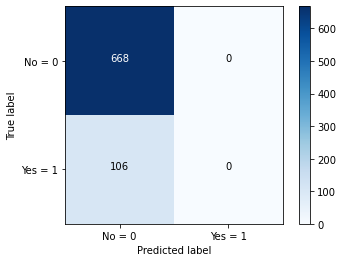

In [74]:
evaluate_model(X_median, y_median, X_test_median, y_test_median, rfc_median)

## 5. Decision Tree

In [75]:
from sklearn.tree import DecisionTreeClassifier
import sklearn.tree as tree

### 5.1. Drop Values

In [76]:
# Values used to train the model: X_drop, y_drop
# Values used to test the model: X_test_drop, y_test_drop

# Train Model and Predict 
tree_drop = DecisionTreeClassifier(criterion = "entropy", max_depth = 4).fit(X_drop, y_drop)
y_hat_drop_tree = tree_drop.predict(X_test_drop)

Train set Accuracy:  0.8696109358569927
Test set Accuracy:  0.72
Jaccard index 0's:  0.7083333333333334
Jaccard index 1's:  0.125


              precision    recall  f1-score   support

         0.0       0.85      0.81      0.83        42
         1.0       0.20      0.25      0.22         8

    accuracy                           0.72        50
   macro avg       0.53      0.53      0.53        50
weighted avg       0.75      0.72      0.73        50





<Figure size 432x288 with 0 Axes>

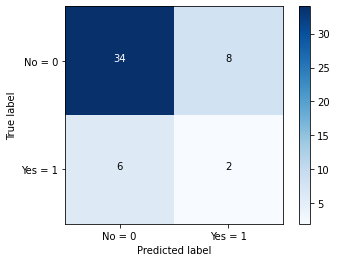

In [77]:
evaluate_model(X_drop, y_drop, X_test_drop, y_test_drop, tree_drop)

### 5.2. Zero Values

In [78]:
# Values used to train the model: X_zero, y_zero
# Values used to test the model: X_test_zero, y_test_zero

# Train Model and Predict 
tree_zero = DecisionTreeClassifier(criterion = "entropy", max_depth = 4).fit(X_zero, y_zero)
y_hat_zero_tree = tree_zero.predict(X_test_zero)

Train set Accuracy:  0.8696109358569927
Test set Accuracy:  0.759235668789809
Jaccard index 0's:  0.750330250990753
Jaccard index 1's:  0.12903225806451613


              precision    recall  f1-score   support

         0.0       0.88      0.84      0.86       677
         1.0       0.20      0.26      0.23       108

    accuracy                           0.76       785
   macro avg       0.54      0.55      0.54       785
weighted avg       0.78      0.76      0.77       785





<Figure size 432x288 with 0 Axes>

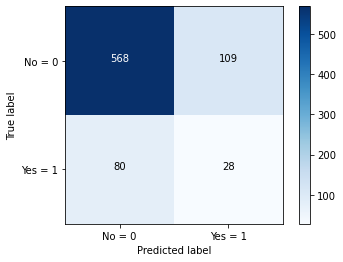

In [79]:
evaluate_model(X_zero, y_zero, X_test_zero, y_test_zero, tree_zero)

### 5.3. Mean Values

In [80]:
# Values used to train the model: X_mean, y_mean
# Values used to test the model: X_test_mean, y_test_mean

# Train Model and Predict 
tree_mean = DecisionTreeClassifier(criterion = "entropy", max_depth = 4).fit(X_mean, y_mean)
y_hat_mean_tree = tree_mean.predict(X_test_mean)

Train set Accuracy:  0.8696109358569927
Test set Accuracy:  0.7609819121447028
Jaccard index 0's:  0.7523427041499331
Jaccard index 1's:  0.12735849056603774


              precision    recall  f1-score   support

         0.0       0.88      0.84      0.86       668
         1.0       0.20      0.25      0.23       106

    accuracy                           0.76       774
   macro avg       0.54      0.55      0.54       774
weighted avg       0.78      0.76      0.77       774





<Figure size 432x288 with 0 Axes>

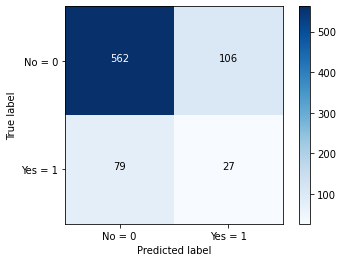

In [81]:
evaluate_model(X_mean, y_mean, X_test_mean, y_test_mean, tree_mean)

### 5.4. Median Values

In [82]:
# Values used to train the model: X_median, y_median
# Values used to test the model: X_test_median, y_test_median

# Train Model and Predict 
tree_median = DecisionTreeClassifier(criterion = "entropy", max_depth = 4).fit(X_median, y_median)
y_hat_median_tree = tree_median.predict(X_test_median)

Train set Accuracy:  0.8696109358569927
Test set Accuracy:  0.851421188630491
Jaccard index 0's:  0.8500651890482399
Jaccard index 1's:  0.05737704918032787


              precision    recall  f1-score   support

         0.0       0.87      0.98      0.92       668
         1.0       0.30      0.07      0.11       106

    accuracy                           0.85       774
   macro avg       0.59      0.52      0.51       774
weighted avg       0.79      0.85      0.81       774





<Figure size 432x288 with 0 Axes>

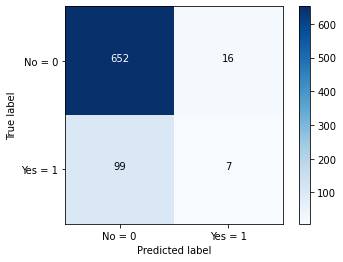

In [83]:
evaluate_model(X_median, y_median, X_test_median, y_test_median, tree_median)

Se puede observar como, a pesar de que los resultados tras evaluar el modelo como un conjunto son muy elevados, la capacidad de predecir casos positivos de dislexia es inexistente. Esto se debe a que el porcentaje de disléxicos es mucho menor que el de no dislexicos, ya que en la población solo el 10% es disléxico. Sin embargo, aunque sí es una muestra significativa, el peso de los síes es mucho menor que el de los noes y por ello se van a aplicar distintas formar de manejo de desproporción de clases.